<!--start-block-->
<hr style="height: 1px;">
<i>This code was authored by the 8.316 Course Team, Copyright 2023 MIT All Rights Reserved.</i>
<hr style="height: 1px;">
<br>

# LECTURE 15 : Numerical ODE Simulations



<a name='section_15_0'></a>
<hr style="height: 1px;">


## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.0 Overview of Learning Objectives</h2>


In this part of the course, we are going to cover numerical simulation. This is often the core of computational physics courses. However, as we will see, this part goes hand-in-hand with analyzing data. We have already seen that numerical simulation can play a critical role in how we buid an understanding of data. This part of the class will cover the core numerical simulations and projects that are present in a variety of fields, and we are quickly seeing more and more subfields are adopting numerical simulations. 

In this lecture, however, we step back from modern physics and we will go back to the 17th century to solve the most famous physics problem of them all: **The Pendulum** . Don't worry byt the end of this lecture we will be solving it with deep learning. 

 - Fitting an arbitrary 1D dataset with a neural net
 - Deep Learning Numerical Solvers
 - Physics informed Machine Learning
 


Before we do anything, lets make sure we install the tools we need for this. 


In [ ]:
import imageio
from PIL import Image

import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

import matplotlib.pyplot as plt
import numpy as np
from scipy.integrate import odeint
from scipy.optimize import minimize
import csv
from matplotlib.patches import Circle
from scipy.integrate import solve_ivp
#http://fy.chalmers.se/~f7xiz/TIF080/pendulum.pdf
#nbody
#https://courses.physics.ucsd.edu/2019/Winter/physics141/Lectures/Lecture14/renaud_thesis.pdf
#https://www.tat.physik.uni-tuebingen.de/~schaefer/teach/fum2020/f/nbody_slides.pdf
#https://github.com/bacook17/behalf/blob/master/behalf/octree.py
#https://anaroxanapop.github.io/behalf/#Code

<h3>Setting Default Figure Parameters</h3>

The following code cell sets default values for figure parameters.


In [ ]:
#>>>RUN: L10.0-runcell02

#set plot resolution
%config InlineBackend.figure_format = 'retina'

#set default figure parameters
plt.rcParams['figure.figsize'] = (9,6)

medium_size = 12
large_size = 15

plt.rc('font', size=medium_size)          # default text sizes
plt.rc('xtick', labelsize=medium_size)    # xtick labels
plt.rc('ytick', labelsize=medium_size)    # ytick labels
plt.rc('legend', fontsize=medium_size)    # legend
plt.rc('axes', titlesize=large_size)      # axes title
plt.rc('axes', labelsize=large_size)      # x and y labels
plt.rc('figure', titlesize=large_size)    # figure title

<a name='section_15_1'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.1 The pendulum  simulating it</h2>  



Every good physic class talks about the pendulum. This is that class. We can write the force for a pendulum wihtout friction as 
$$
m \ell \ddot{\theta} = -m g\sin \theta
$$
where we have $\ddot{\theta}$ denotes the second time derivative of the angle of the pendulum given by $\theta(t)$, and $\ell$ is the length of the pendulum, and $g$ is the gravitational constant. 

Now traditionally, this is simplified to the differential equation given by 
$$
\frac{d}{dt}\dot{\theta} = -\frac{g}{\ell}\sin \theta
$$
and then we take the small angle approximation $\theta \ll 1$ that give us
$$
\frac{d}{dt}\dot{\theta} = -\frac{g}{\ell} \theta
$$
and we know the solution to this equation is given by 

$$
\theta(t) = \theta_{0} \cos\left(\sqrt{\frac{g}{\ell}} t + \phi\right)
$$
where we have $\theta_{0}$ depends on our initial position at time $t=0$, and $\phi$ also depends on the initial velocity at $t=0$. 

However, in reality, this equation is not really exactly what is going on. To see that, lets set up a simulation that computes the force, and steps forward.  We will do this in the most naive way possible, by just stepping and propagating. 

To do that, we will define a step $\Delta t$, and then we will update our velocity and position at each step by noting 
$$
\theta_{n+1} = \theta_{n} + \Delta t \dot{\theta}_{n}\\
\dot{\theta}_{n+1} = \dot{\theta}_{n} - \Delta t \frac{g}{\ell} \theta \\
$$

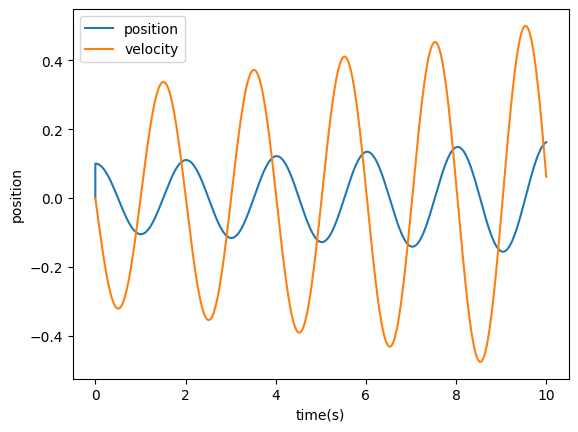

In [493]:
#theta[0]=x
#theta[1]=v

def step(theta,dt,g,l):
    theta_tmp  = theta[0]
    theta_vtmp = theta[1] 
    theta[0] += theta_vtmp * dt
    theta[1] += (g/l)*(-1)*theta_tmp*dt

def store(theta,thetapos,time,timepos):
    thetapos = np.vstack((thetapos,theta))
    timepos  = np.vstack((timepos,time))
    return timepos,thetapos
    
def loop(istep, nsteps=1000,dt=0.01,g=9.8,l=1):
    timepos  = np.zeros(1)
    thetapos = np.zeros((1,2));
    time     = 0
    theta    = np.zeros(2)
    theta[0] = 0.1 #initial conditions
    theta[1] = 0.0
    timepos,thetapos=store(theta,thetapos,time,timepos)
    for timestep in range(nsteps):
        istep(theta,dt,g,l)
        time += dt
        timepos,thetapos=store(theta,thetapos,time,timepos)
    return timepos,thetapos

timepos,thetapos=loop(step,nsteps=1000)

plt.plot(timepos,thetapos[:,0],label="position")
plt.plot(timepos,thetapos[:,1],label="velocity")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()


Clearly, there is something. Go ahead and runt the simulation with 10,000 steps, what happens? 

Now we can go one step further, and on top of the above comput the total energy of our setup. Let's go ahead and do it. We can define the total energy as 

$$
H = \frac{p^2}{2m} + V(\theta)\\
~ = \frac{1}{2}m\ell^{2}\dot{\theta}^{2} - mg\ell\cos(\theta)\\
~ = m\ell\left(\frac{1}{2}\ell\dot{\theta}^{2} - g\cos(\theta)\right)\\
$$

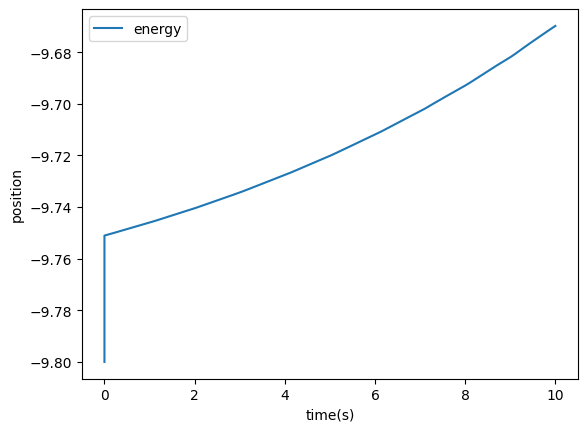

In [494]:
def energy(theta,g=9.8,l=1):
    kin=0.5*(l*theta[:,1])**2
    pot=-g*l*np.cos(theta[:,0])
    return kin+pot 

epos = energy(thetapos)

plt.plot(timepos,epos,label="energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()


We see that our energy is growing with time, clearlly its not conserved. 

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.1.1 </span>

Compute the difference in energy for a step $\Delta t$? for $\theta_0=0$. 


$$
\mathcal{H_{0}}   = m\ell\left(\frac{1}{2}\ell\dot{\theta_{0}}^{2} - g\cos(\theta_{0})\right)\\
\theta_{1}        = \theta_{0} + \Delta t \dot{\theta}_{0}\\
\dot{\theta}_{1}  = \dot{\theta}_{0} - \Delta t \frac{g}{\ell} \theta_{0} \\
\mathcal{H_{1}}   = m\ell\left(\frac{1}{2}\ell\dot{\theta_{1}}^{2} - g\cos(\theta_{1})\right)\\
\mathcal{H_{1}}   = m\ell\left(\frac{1}{2}\ell(\dot{\theta}_{0} - \Delta t \frac{g}{\ell} \theta_{0})^{2} - g\cos(\theta_{0} + \Delta t \dot{\theta}_{0})\right)\\
$$
Now we can write the difference in energy as 
$$
\mathcal{H_{1}}-\mathcal{H_{0}} =  m\ell\left(\frac{1}{2}\ell(\Delta t \frac{g}{\ell} \theta_{0})^{2} - 2\dot{\theta}_{0}\Delta t \frac{g}{\ell} \theta_{0}) - g\cos(\theta_{0} + \Delta t \dot{\theta}_{0})+ g\cos(\theta_{0})\right)\\
$$
, which if we take $\theta_{0}=0$ we have 

$$
\mathcal{H_{1}}-\mathcal{H_{0}} =  m\ell g\left( - \cos(\Delta t \dot{\theta}_{0})+ 1\right)\\
$$
and expanding $\cos(\Delta t \dot{\theta}_{0})$ we have 

$$
\mathcal{H_{1}}-\mathcal{H_{0}} =  -m\ell g\left(\frac{1}{2}\dot{\theta}_{0}^{2}\right)\\
$$

Which is not zero, and its also dependent on the velocity $\dot{\theta_{0}}$ and $\Delta t$


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.1.2 </span>

Show that the energy changes with step size over the same period of time. 


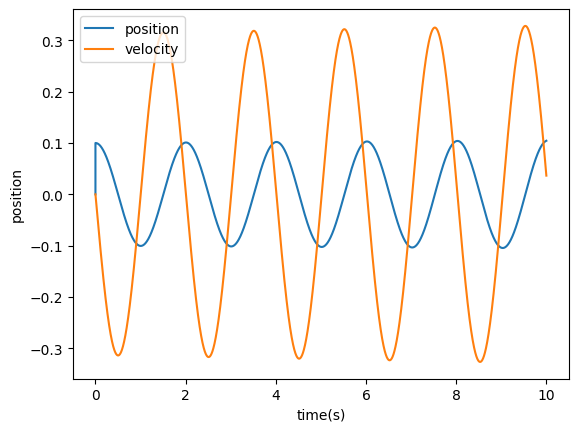

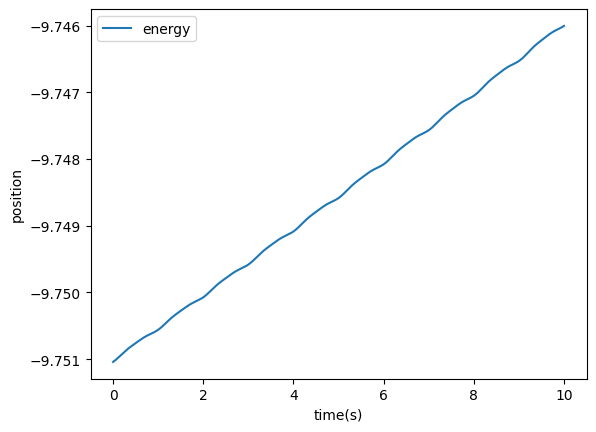

In [495]:
timepos,thetapos=loop(step,nsteps=10000,dt=0.001)

plt.plot(timepos,thetapos[:,0],label="position")
plt.plot(timepos,thetapos[:,1],label="velocity")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

epos = energy(thetapos)

plt.plot(timepos[1:-1],epos[1:-1],label="energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()



Importantly, we need to step our simulation the same total time $n_{\rm steps} \times \Delta t$. We see teh energy change is 0.005 when compared with something that is 0.07. 

<a name='section_15_2'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.2 The symplectic Approach</h2>  



We can generalize the above to what we consider the "Symplectic" approach, which just follows Hamilton's equations. Whereby we know the change in position is defined as a derivative to the Hamiltonian with respect to momentum gives: 

$$ 
\frac{\partial \mathcal{H} }{ \partial p_{i} } = \dot{q}_{i} 
$$ 

and the derivative with respecct to the Hamiltonian with respect to position $q_{i}$ gives us the time derivative of momentum. 

$$ \frac{\partial \mathcal{H} }{ \partial q_{i} } = -\dot{p}_{i} $$  

If we know what $p$ is and if we know our force, or potential, this governs everything. 

Solving for the motion through the Hamiltonian, while seemingly simple, can get progressively more complicated as we start to probe the finer details of what is going on. This is particularly true we are trying to integrate complex formulae. Before we go to solving for motion in a physics problem, lets jump to a generic 

Let's consider solving a generic equation. Let's right 

$$\frac{dx}{dt} = f(x,t) $$ 

The full solution of this problem would give us 

$$ \int dx = \int f(x,t) dt $$ or 

$$ x(t)-x_0 = \int_{t_{0}}^{t} f(x,t) dt $$

We where have taken the liberty to add one more piece of information, that at some time $x(t_{0})=x_{0}$. The simplest way to integrate this guy is then to perform the Euler's method, which is just the inverse of a Taylor expansion, or a stepwise integration. 

We can write this as. 

$$x_{1}(t_{0}+\Delta t) = x_0 + f(t_{0},x_{0})\Delta t$$

Moreover, we can then step this integral using our knowledge of $f$ to write a recursive relation for $x(t)$ given by 

$$x_{n}(t) = x_{n-1} + f(t_{n-1},x_{n-1})\Delta t $$

This is known as Euler's method for first order differential equations. This is what we did in the first section. 

Now the second, more sophisticated approach is to do this with a second order term namely. 

$$x_{1}(\Delta t) = x_0 + f(t_{0},x_{0})\Delta t  + \frac{1}{2} \frac{df}{dt}(t_{0},x_{0})\Delta t^{2} $$

and recursively we can write 

$$x_{n}(t) = x_{n-1} + f(t_{n-1},x_{n-1})\Delta t  + \frac{1}{2} \frac{df}{dt}(t_{n-1},x_{n-1})\Delta t^{2} $$

Let's see how that works. 


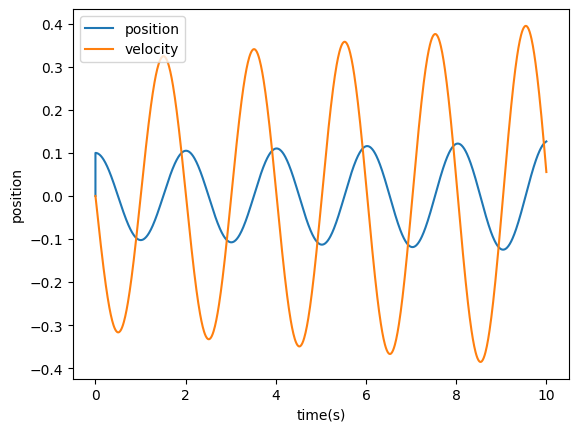

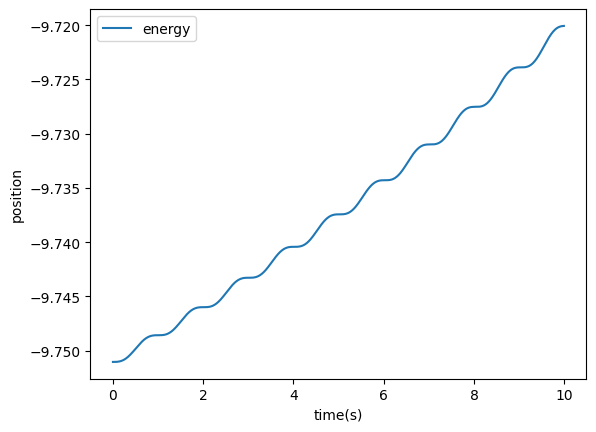

In [496]:
def step(theta,dt,g,l):
    theta_tmp  = theta[0]
    theta_vtmp = theta[1] 
    theta[0] += theta_vtmp * dt + 0.5*(g/l)*(-1)*theta_tmp*dt**2
    theta[1] += (g/l)*(-1)*np.sin(theta_tmp)*dt
    #theta[1] += (g/l)*(-1)*theta_tmp*dt

    
def energy(theta,g=9.8,l=1):
    kin=0.5*l*l*theta[:,1]**2
    pot=-g*l*np.cos(theta[:,0])
    return kin+pot 

timepos,thetapos=loop(step,nsteps=1000,dt=0.01)

plt.plot(timepos,thetapos[:,0],label="position")
plt.plot(timepos,thetapos[:,1],label="velocity")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

timepos,thetapos=loop(step,nsteps=1000,dt=0.01)
epos = energy(thetapos)

plt.plot(timepos[1:-1],epos[1:-1],label="energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()


Now, we can formalize this into what is often referred to as Hamiltonian Monte Carlo, by writing step equations from the hamiltonian motion. For a time step $\Delta t$ we can make an interconnected set of integration in momentum and position following the Hamiltonian MC. This we can write as: 

$$ 
q_{n+1} =  q_{n} + \Delta t \frac{\partial \mathcal{H} }{ \partial p_{i} }
$$


and the derivative with respecct to the Hamiltonian with respect to position $q_{i}$ gives us the time derivative of momentum. 

$$ 
p_{n+1} = p_{n} + \Delta t \frac{\partial \mathcal{H} }{ \partial q_{i} }
$$  

Thinking about this in the context of the Hamiltonian is critical because we have some conservation laws that we can use. In particular, through the conservation of phase space. 
$$
\frac{d\mathcal{H}}{dt} = \frac{\partial \mathcal{H} }{ \partial q_{i} } \frac{dq_{i}}{dt} +  \frac{\partial \mathcal{H} }{ \partial p_{i} } \frac{dp_{i}}{dt}\\
\frac{d\mathcal{H}}{dt} = -\frac{dp_{i}}{dt} \frac{dq_{i}}{dt} +  \frac{dq_{i}}{dt}\frac{dp_{i}}{dt}=0\\
$$



### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.2.1 </span>

Compare the energy conservation for a quadratic approxiamtion of the Euler method vs the quadratic approximation over a period of 10s. What is the change in energy over the period? 

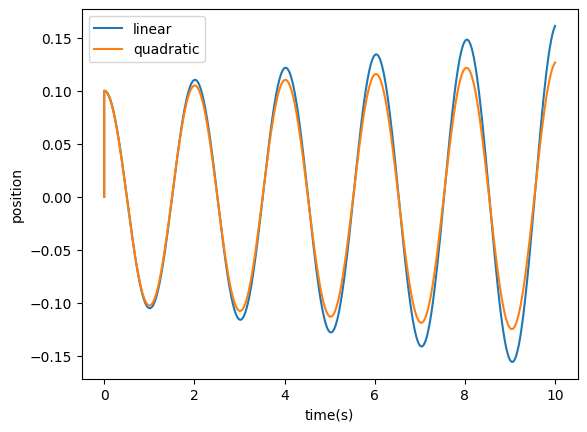

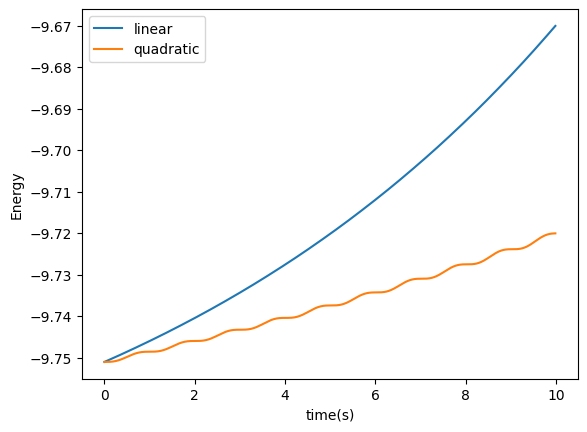

In [497]:
def stepq(theta,dt,g,l):
    theta_tmp  = theta[0]
    theta_vtmp = theta[1] 
    theta[0] += theta_vtmp * dt + 0.5*(g/l)*(-1)*theta_tmp*dt**2
    theta[1] += (g/l)*(-1)*np.sin(theta_tmp)*dt
    #theta[1] += (g/l)*(-1)*theta_tmp*dt

def stepl(theta,dt,g,l):
    theta_tmp  = theta[0]
    theta_vtmp = theta[1] 
    theta[0] += theta_vtmp * dt 
    theta[1] += (g/l)*(-1)*np.sin(theta_tmp)*dt
    #theta[1] += (g/l)*(-1)*theta_tmp*dt

    
timeposl,thetaposl=loop(stepl,nsteps=1000,dt=0.01)
timeposq,thetaposq=loop(stepq,nsteps=1000,dt=0.01)
plt.plot(timeposl,thetaposl[:,0],label="linear")
plt.plot(timeposq,thetaposq[:,0],label="quadratic")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

eposl = energy(thetaposl)
eposq = energy(thetaposq)
plt.plot(timepos[1:-1],eposl[1:-1],label="linear")
plt.plot(timepos[1:-1],eposq[1:-1],label="quadratic")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("Energy")
plt.show()


<a name='section_15_3'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.3 The Leap-frog/Verlet Approach</h2>  


Now to be honest we can go approximate things with higher and higher orders. However, there is a really quick fix that we can do to start to conserve Energy. This conservation stems from the fact that our estimates for the propagation tend to go in one direction. 

For the Harmonic oscillator, we can derive the lack of enrgy conservation by noting that we can write the step updates for the harmonic oscillator with a Hamiltonian given by 

$$
\mathcal{H} = \frac{1}{2} q^2 + \frac{1}{2} p^2
$$

The step updates can be written as: 

$$
\begin{pmatrix}
p_{n+1} \\
q_{n+1} 
\end{pmatrix}
=
\begin{pmatrix}
\cos(\Delta t) & \sin(\Delta t) \\
-\sin(\Delta t) & \cos(\Delta t) 
\end{pmatrix}
\begin{pmatrix}
p_{n} \\
q_{n} 
\end{pmatrix}
$$

Which we can approximate as : 


$$
\begin{pmatrix}
p_{n+1} \\
q_{n+1} 
\end{pmatrix}
=
\begin{pmatrix}
1 & \Delta t \\
-\Delta t & 1
\end{pmatrix}
\begin{pmatrix}
p_{n} \\
q_{n} 
\end{pmatrix}
$$

We gives us the updates
$$
q_{n+1} = q_{n} + \Delta t p_{n}\\
p_{n+1} = p_{n} - \Delta t q_{n}
$$

We can then write the Hamiltonian for the $n+1$ as 

$$
\mathcal{H}_{n+1} = \frac{1}{2} \left(q_n + \Delta t p_{n}\right)^{2} +  \frac{1}{2} \left( p_{n} - \Delta t q_{n}\right)^{2} \\
\mathcal{H}_{n+1} = \frac{1}{2} q_{n}^2  + \frac{1}{2} p_{n}^2 + \frac{\Delta t^2}{2} \left(p_n^2  +  q_{n}^2\right) \\
\mathcal{H}_{n+1} = \frac{\left(1+\Delta t^2\right)}{2}\left( q_{n}^2  +  p_{n}^2\right)\\
$$

This clearly doesn't conserve energy, and we see it is $\Delta t $ dependent. In light of that, what we can do is come up with ways to mitigate this strategy. One simple way is to update the Hamiltonian one at a time. This gives us an update that just has one update: 

$$
\mathcal{H}_{n+1} = \frac{1}{2} \left(q_n \right)^{2} +  \frac{1}{2} \left( p_{n} - \Delta t q_{n}\right)^{2} \\
\mathcal{H}_{n+1} = \frac{1}{2} q_{n}^2  + \frac{1}{2} p_{n}^2 +  \left(\frac{\Delta t^2}{2} p_n^2  - 2 \Delta t q_{n}p_{n} \right) \\
$$

Then we update $q_{n}$ with the updated value of $p_{n+1}$  the resulting Hamiltonian is:

$$
\mathcal{H}_{n+1} = \frac{1}{2} \left(q_n \right)^{2} +  \frac{1}{2} \left( p_{n} - \Delta t q_{n}\right)^{2} \\
\mathcal{H}_{n+1} = \frac{1}{2} q_{n}^2  + \frac{1}{2} p_{n}^2 +  \left(\frac{\Delta t^2}{2} p_n^2  - 2 \Delta t q_{n}p_{n} \right) \\
$$

$$
\begin{pmatrix}
p_{n+1} \\
q_{n+1} 
\end{pmatrix}
=
\begin{pmatrix}
1 & -\Delta t \\
0 & 1
\end{pmatrix}
\begin{pmatrix}
1 & 0 \\
\Delta t & 1
\end{pmatrix}
\begin{pmatrix}
p_{n} \\
q_{n} 
\end{pmatrix}
$$


$$
\begin{pmatrix}
p_{n+1} \\
q_{n+1} 
\end{pmatrix}
=
\begin{pmatrix}
1 & -\Delta t \\
0 & 1
\end{pmatrix}
\begin{pmatrix}
p_{n} \\
q_{n}+p_{n}\Delta t 
\end{pmatrix}
$$

$$
\begin{pmatrix}
p_{n+1} \\
q_{n+1} 
\end{pmatrix}
=
\begin{pmatrix}
p_{n} - \Delta t (q_{n}+p_{n}\Delta t )  \\
q_{n}+p_{n}\Delta t 
\end{pmatrix}
$$

We can now write the total energy of the system as 

$$
E = \frac{1}{2} \left(p_{n}^2 + q_{n}^2 + \Delta t^2 (-p_{n}^2+q_{n}^2) + 2\Delta t^3 p_{n} q_{n} + \Delta t^4 p_{n}^2 \right) 
$$

This differs from before in the sense that we now have a term that is not exclusively positive $\Delta t^2 (p_{n}^2-q_{n}^2)$. However since the determinant of each step is 1, we have that the steps are by construction volume preserving, which means that this iterative procedure yields a conserved quantity.   


We can write this conserved quantity noting that 

$$
\Delta t p_{n+1} q_{n+1}  = \Delta t p_{n} q_{n} -  \Delta t^2 p_{n}^2 +  \Delta t^2 q_{n}^2 - 2 \Delta t^3 p_{n} q_{n} - \Delta t^4 p_{n}^2 \\
$$
Implies that 

$$
E_{n+1} + \Delta t p_{n+1} q_{n+1} = E_{n} + \Delta t p_{n} q_{n}
$$

Or in otherwords, we have construced a conserved quantity. However, it is not the conserved quantity that we wish to conserve. As a consequence, while our approximation is volume preserving, it does not ensure the energy is conserved. 

In any case, what the above state of operations does imply is that we can alternate applications to get a better update. Let's go ahead and step that. 

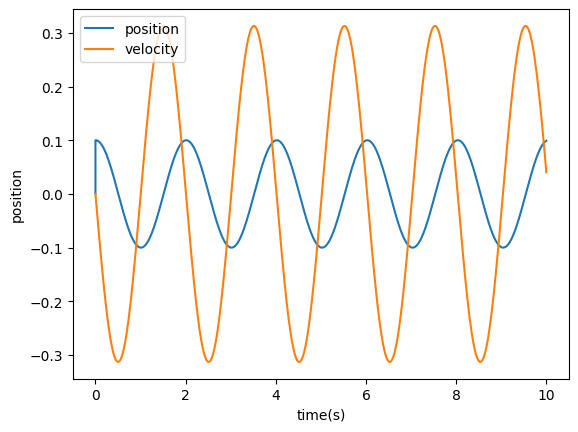

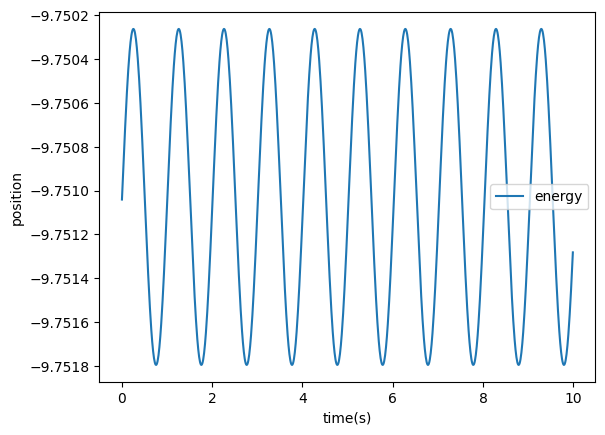

In [498]:
def altstep(theta,dt,g,l):
    theta[0] += theta[1] * dt 
    theta[1] += (g/l)*(-1)*np.sin(theta[0])*dt
    
def loop(istep,nsteps=1000,dt=0.01,g=9.8,l=1):
    timepos  = np.zeros(1)
    thetapos = np.zeros((1,2));
    time     = 0
    theta    = np.zeros(2)
    theta[0] = 0.1 #initial conditions
    theta[1] = 0.0
    #theta[1] += (g/l)*(-1)*theta[0]*dt*0.5 #half step
    timepos,thetapos=store(theta,thetapos,time,timepos)
    for timestep in range(nsteps):
        istep(theta,dt,g,l)
        time += dt
        timepos,thetapos=store(theta,thetapos,time,timepos)
    return timepos,thetapos


timepos,thetapos=loop(altstep,nsteps=1000,dt=0.01)
plt.plot(timepos,thetapos[:,0],label="position")
plt.plot(timepos,thetapos[:,1],label="velocity")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

epos = energy(thetapos)

plt.plot(timepos[1:-1],epos[1:-1],label="energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()


Now this alternation gets us to the leap-frog/verlet algorithm whereby we just altnerate updates. The formal algorithm proceeds in 3 steps : 

  * $p_{n+\frac{1}{2}} = p_{n} - \frac{\Delta t}{2} \frac{\partial \mathcal{H}}{\partial{q}} \left(q_{n}\right)$
  * $q_{n+1}           = q_{n} + \Delta t \frac{\partial \mathcal{H}}{\partial{p}} \left(p_{n+\frac{1}{2}}\right)$
  * $p_{n+1}           = p_{n+\frac{1}{2}} - \frac{\Delta t}{2} \frac{\partial \mathcal{H}}{\partial{q}} \left(q_{n+1}\right)$
  
Which we iterate over an over again. Let's go ahead and implement this, its really the same as above, but with a half step. 

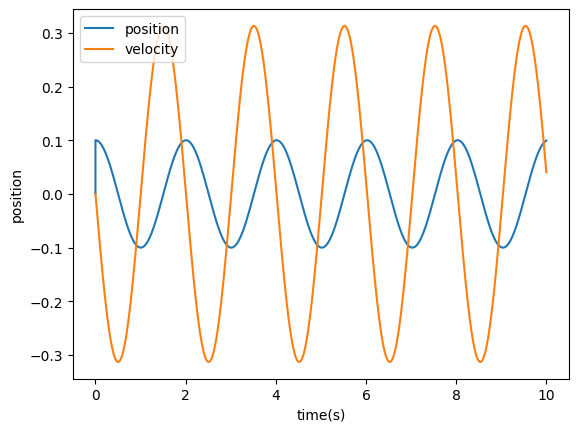

E0: -9.751040819724652 E1: -9.751041017809632


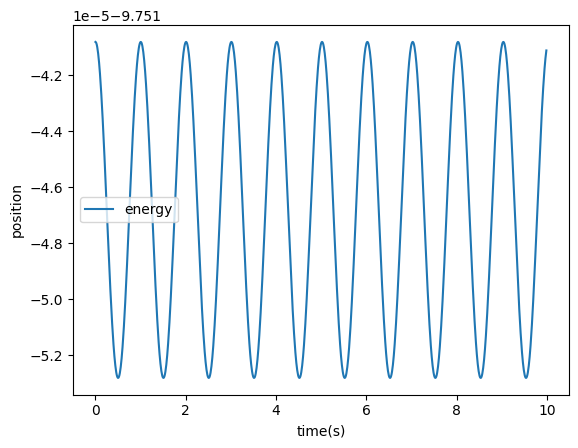

In [499]:
def lfstep(theta,dt,g,l):
    theta[1] += 0.5*(g/l)*(-1)*np.sin(theta[0])*dt
    theta[0] += theta[1] * dt 
    #theta[1] += (g/l)*(-1)*theta[0]*dt
    theta[1] += 0.5*(g/l)*(-1)*np.sin(theta[0])*dt
    
def loop(istep,nsteps=1000,dt=0.01,g=9.8,l=1):
    timepos  = np.zeros(1)
    thetapos = np.zeros((1,2));
    time     = 0
    theta    = np.zeros(2)
    theta[0] = 0.1 #initial conditions
    theta[1] = 0.0
    #theta[1] += (g/l)*(-1)*theta[0]*dt*0.5 #half step
    timepos,thetapos=store(theta,thetapos,time,timepos)
    for timestep in range(nsteps):
        istep(theta,dt,g,l)
        time += dt
        timepos,thetapos=store(theta,thetapos,time,timepos)
    return timepos,thetapos


timepos,thetapos=loop(lfstep,nsteps=1000,dt=0.01)
plt.plot(timepos,thetapos[:,0],label="position")
plt.plot(timepos,thetapos[:,1],label="velocity")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

epos = energy(thetapos)
print("E0:",epos[1],"E1:",epos[-1])

plt.plot(timepos[1:-1],epos[1:-1],label="energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()


The above procedure is known as the Leap-Frog or Leap-Frog Verlet procedure. The leap frog shoudl be pretty clear, we are effectively jumping updates between position and momentum. The big advantage to this is that it is volume preserving, given that the determinant is 1. 

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.3.1 </span>

Let's try to understand how energy is conserved in leap frog. 

Take the above position, velocity and energy distributions and rescale them so their mean is 0 and the range is +/- 1. What is the frequency of the energy variation? 

E0: 0.501354498960011 E1: 0.4848267560504126 Delta 1.0 Delta E 4.974973044369335e-05


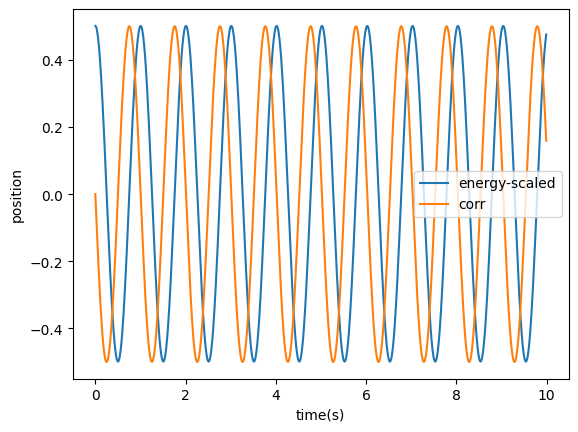

In [500]:
def energycons(theta,dt=0.0001):
    kin=0.5*l*theta[:,1]**2
    pot=-g*l*np.cos(theta[:,0])
    term=dt*np.sin(theta[:,1])*np.sin(theta[:,0])*np.sqrt(g)*l
    return kin+pot,term

#def energy(theta,g=9.8,l=1):
#    kin=0.5*l*theta[:,1]**2
#    pot=-g*l*np.cos(theta[:,0])
#    return kin+pot 

epos,term = energycons(thetapos)
epos-=np.mean(epos[1:-1])
term-=np.mean(term[1:-1])
thetapos-=np.mean(thetapos[1:,-1])
delta=(np.max(epos[1:-1])-np.min(epos[1:-1]))/(np.abs(np.max(epos[1:-1]))+np.abs(np.min(epos[1:-1])))
deltaE=(np.max(epos[1:-1])-np.min(epos[1:-1]))
deltaM=(np.max(term[1:-1])-np.min(term[1:-1]))
deltaT0=(np.max(thetapos[1:-1,0])-np.min(thetapos[1:-1,0]))
deltaT1=(np.max(thetapos[1:-1,1])-np.min(thetapos[1:-1,1]))
epos/=deltaE
term/=deltaM
thetapos[:,0]/=deltaT0
thetapos[:,1]/=deltaT1
print("E0:",epos[1],"E1:",epos[-1],"Delta",delta,"Delta E",deltaE)
term += np.mean(epos[1:-1])
plt.plot(timepos[1:-1],epos[1:-1],label="energy-scaled")
#plt.plot(timepos[1:-1],thetapos[1:-1,0],label="position scaled")
#plt.plot(timepos[1:-1],thetapos[1:-1,1],label="velocity scaled")
plt.plot(timepos[1:-1],term[1:-1],label="corr")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
Everything is going at double frequency to position or velocity. 
</pre>
        
**EXPLANATION:**
This is the same is our cross term $pq\Delta t$. However the phase is shifted relative to our actual reading. 

</div>

<a name='section_15_3'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.4 Runge-Kutta </h2>  


Once we advance the concepts of integral apprxoimation. We can start to play numerical tricks to get to very high precision. There has been a lot of work along these lines over time. Perhaps the most well known, and commonly used is the Runge-Kutta Algorithm. 

Finally, we can do something a bit more complicated by defining a differential equation thats a function of time and our position. What we can evnision is our velocity function, is a function of $\theta$ and time $t$

$$
\dot{\theta} = \theta_{v}(\theta,t) \\
\theta_{v}(\theta,t) \approx \dot{\theta} - \frac{g}{l} \Delta t \sin(\theta) 
$$
Likewise we can envision the acceleration as a function of time and acceleration. 

$$
\ddot{\theta} = \theta_{a}(\dot{\theta},t) \\
\theta_{a}(\theta,t) = - \frac{g}{l} \Delta t \sin(\theta) 
$$

What we can then do is step velocity and acceleration hand in hand

$$
\theta_{n+1}       = \theta_{n}       + \frac{\Delta t}{2} (\dot{\theta}_n + \dot{\theta}_{n+1}) \\
\dot{\theta}_{n+1} = \dot{\theta}_{n} + \frac{\Delta t}{2} (\ddot{\theta}_n + \ddot{\theta}_{n+1}) 
$$



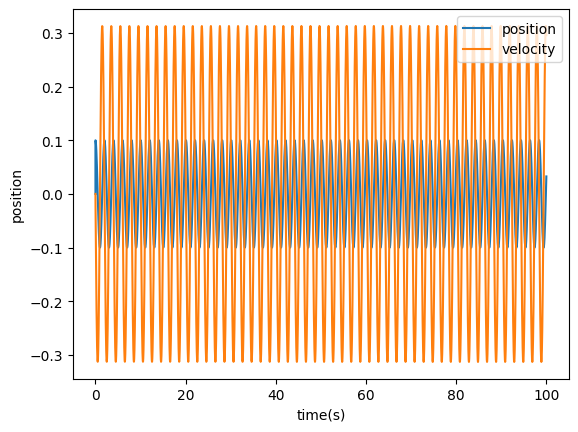

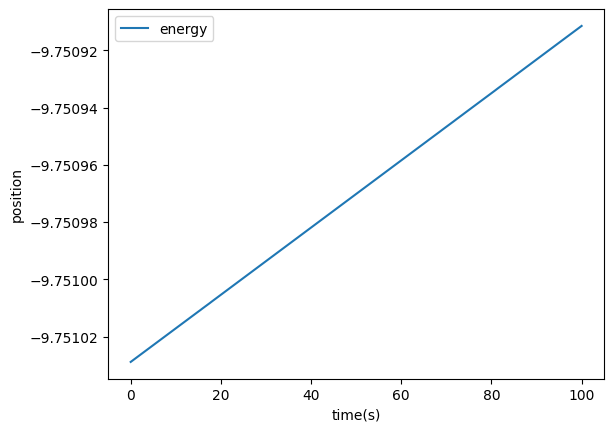

In [504]:
## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.6 Fitting the full thing </h2>  
def thetaa(itheta,g,l):
    return -(g/l)*np.sin(itheta)   

def thetav(ithetad):
    return ithetad# - (g/l)*np.sin(itheta)*idt

def rkstep(theta,dt,g,l):
    thetan    = theta[0]
    thetavn   = theta[1]
    thetaan   = thetaa(thetan,g,l)
    #theta[0] += dt*0.5*(thetavn+thetav(thetavn,dt*0.5,thetan,g,l))#current + extrapolated 
    #theta[1] += dt*0.5*(thetaa(theta[0],0,0,g,l) + thetaa(theta[0],dt,thetavn,g,l))
    theta[0] += 0.5*dt*(thetavn + thetav(thetavn+dt*thetaa(thetan,g,l)    ))
    theta[1] += 0.5*dt*(thetaan + thetaa(thetan +dt*thetav(thetavn   ),g,l))

def loop(nsteps=100000,dt=0.01,g=9.8,l=1):
    timepos  = np.zeros(1)
    thetapos = np.zeros((1,2));
    time     = 0
    theta    = np.zeros(2)
    theta[0] = 0.1 #initial conditions
    theta[1] = 0.0
    theta[1] += dt*0.5*(thetaa(theta[0],g,l))
    timepos,thetapos=store(theta,thetapos,time,timepos)
    for timestep in range(nsteps):
        rkstep(theta,dt,g,l)
        time += dt
        timepos,thetapos=store(theta,thetapos,time,timepos)
    return timepos,thetapos


timepos,thetapos=loop(nsteps=10000,dt=0.01)

plt.plot(timepos,thetapos[:,0],label="position")
plt.plot(timepos,thetapos[:,1],label="velocity")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

epos = energy(thetapos)

plt.plot(timepos[1:-1],epos[1:-1],label="energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()



$$
\dot{\theta} = \theta_{v}(\theta,t) \\
\theta_{v}(\theta,t) \approx \dot{\theta} - \frac{g}{l} \Delta t \theta 
$$
from this, we can go ahead and start to extrapolate, but we will do this in a more effective way. While for now we will not expand $\theta_{v}$ like we did on the second-line, but when we implement we will. 

Now the Runge-Kutta approximation, aims to use 4 points to extrapolate to the next point. The way we do this is to expand the expansion of $\theta$, which we can write as
$$
\theta_{n+1} = \theta_{n} + \Delta t \theta_{v}
$$
and expanding this, we can consider moving $t\rightarrow t+\Delta t$, and we can take a bunch of half steps to approximate $\theta$. We do this by defining 
$$
\dot{\theta}_{n}             = \theta_{v}\left(\theta_{n},t_{n}\right) \\
\dot{\theta}_{n+\frac{1}{2}} = \theta_{v}\left(\theta_{n}+\frac{1}{2}\Delta t \dot{\theta}_{n},t_{n}+\frac{1}{2}\Delta t\right) \\
\dot{\theta}_{n+\frac{1}{2}+\Delta} = \theta_{v}\left(\theta_{n}+\frac{1}{2}\Delta t \dot{\theta}_{n+\frac{1}{2}},t+\frac{1}{2}\Delta t\right) \\
\dot{\theta}_{n+1} = \theta_{v}\left(\theta_{n}+\Delta t \dot{\theta}_{n},t+\Delta t\right) \\
$$

This leads us to the Runge-Kutta approximation
$$
\theta_{n+1} = \theta_{n} + \frac{\Delta t}{6} \left(\dot{\theta}_{n+\frac{1}{2}} + 2 \dot{\theta}_{n+\frac{1}{2}+\Delta} + 2 \dot{\theta}_{n+\frac{1}{2}+\Delta_{2}} + \dot{\theta}_{n+1} \right) 
$$
We will not derive this here, mostly because you can google your own derivation and find lots of details. However, we should note that for a high quality numerical approximation, this is the way to go. This effectively apprxoimates functions out to the 5-th order. 

Now for the pendulum, we also have to step $\dot{\theta}$ by the same protocol 
$$
\dot{\theta}_{n+1} = \dot{\theta}_{n} + \frac{\Delta t}{6} \left(\ddot{\theta}_{n+\frac{1}{2}} + 2 \ddot{\theta}_{n+\frac{1}{2}+\Delta} + 2 \ddot{\theta}_{n+\frac{1}{2}+\Delta_{2}} + \ddot{\theta}_{n+1} \right) 
$$

Which you can see from this is a just a scheme of successive approximations that allow us to step things forward. To do this for the pendulum, we have to step both steps at the same time. This is like the leapfrog, but seriously intertwined. Let's take a look at how good it is. 


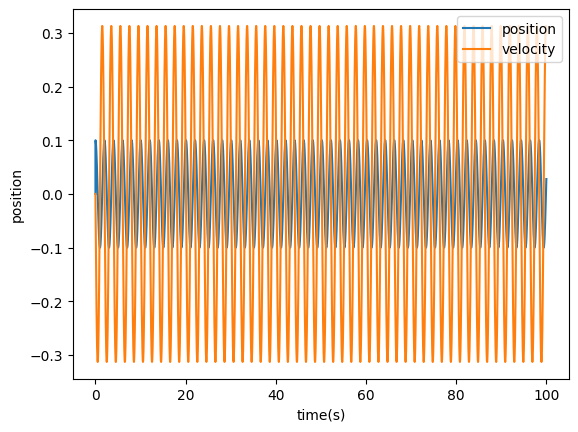

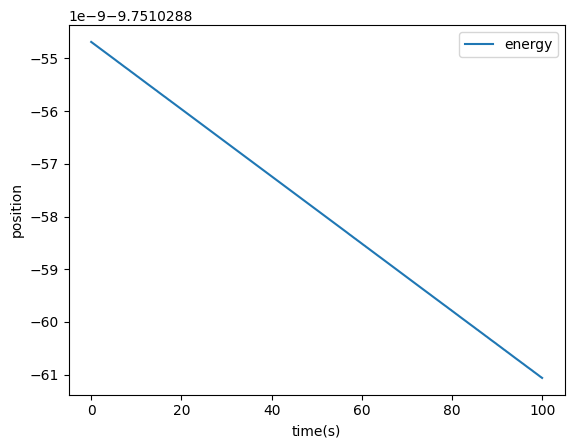

E-start: -9.751028854688002 E-end -9.751028861062562


In [505]:
def rkstep(theta,dt,g,l):
    thetan     = theta[0]
    thetavn    = theta[1]
    thetaan    = thetaa(thetan,g,l)    
    #half step
    thetavn05  = thetav(thetavn  +0.5*dt*thetaan) 
    thetaan05  = thetaa(thetan   +0.5*dt*thetavn,g,l) 
    #half step based on previous half
    thetavn05d = thetav(thetavn  +0.5*dt*thetaan05)    
    thetaan05d = thetaa(thetan   +0.5*dt*thetavn05,g,l)
    #full step based on previous half
    thetavn10  = thetav(thetavn  +1.0*dt*thetaan05d)
    thetaan10  = thetaa(thetan   +1.0*dt*thetavn05d,g,l)
    #runge-Kutta did the math for us
    theta[0] += (1./6.)*dt*(thetavn + 2*thetavn05  + 2*thetavn05d + thetavn10)
    theta[1] += (1./6.)*dt*(thetaan + 2*thetaan05  + 2*thetaan05d + thetaan10)

timepos,thetapos=loop(nsteps=10000,dt=0.01)

plt.plot(timepos,thetapos[:,0],label="position")
plt.plot(timepos,thetapos[:,1],label="velocity")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

epos = energy(thetapos)

plt.plot(timepos[1:-1],epos[1:-1],label="energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

print("E-start:",epos[1],"E-end",epos[-1])

The y-axis variation here is tiny. We can output the input value and the output and take a look at the behavior. From above, we are talking about conservation of energy at $10^{-10}$ level. Thats a bit better than everything we have seen. 


### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.4.1 </span>

Let's now look at the pendulum in the non-linear regime. Run the Runge-Kutta above for an initial $\theta=2.0$. How does conservation of energy look? How about now when, we run the leap-frog? What does a timestep of 0.1 do? 



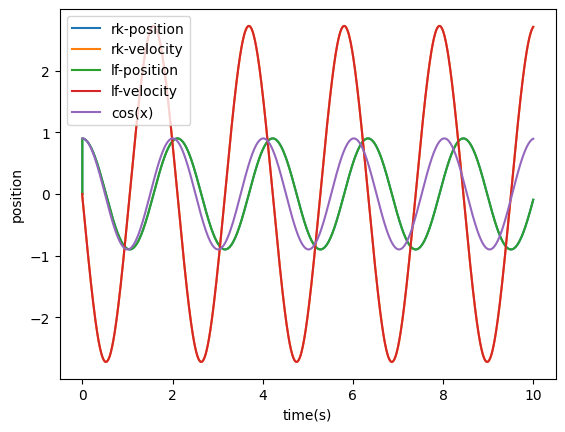

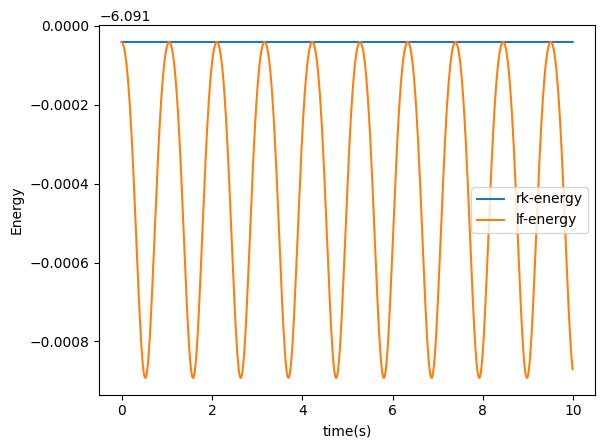

E-start: -9.751028854688002 E-end -9.751028861062562


In [510]:
thetainit=0.9
def rkloop(nsteps=100000,dt=0.01,g=9.8,l=1):
    timepos  = np.zeros(1)
    thetapos = np.zeros((1,2));
    time     = 0
    theta    = np.zeros(2)
    theta[0] = thetainit #initial conditions
    theta[1] = 0.0
    theta[1] += dt*0.5*(thetaa(theta[0],g,l))
    timepos,thetapos=store(theta,thetapos,time,timepos)
    for timestep in range(nsteps):
        rkstep(theta,dt,g,l)
        time += dt
        timepos,thetapos=store(theta,thetapos,time,timepos)
    return timepos,thetapos

def lfloop(nsteps=100000,dt=0.01,g=9.8,l=1):
    timepos  = np.zeros(1)
    thetapos = np.zeros((1,2));
    time     = 0
    theta    = np.zeros(2)
    theta[0] = thetainit #initial conditions
    theta[1] = 0.0
    theta[1] += dt*0.5*(thetaa(theta[0],g,l))
    timepos,thetapos=store(theta,thetapos,time,timepos)
    for timestep in range(nsteps):
        lfstep(theta,dt,g,l)
        time += dt
        timepos,thetapos=store(theta,thetapos,time,timepos)
    return timepos,thetapos


rktimepos,rkthetapos=rkloop(nsteps=1000,dt=0.01)
lftimepos,lfthetapos=lfloop(nsteps=1000,dt=0.01)

plt.plot(rktimepos,rkthetapos[:,0],label="rk-position")
plt.plot(rktimepos,rkthetapos[:,1],label="rk-velocity")
plt.plot(lftimepos,lfthetapos[:,0],label="lf-position")
plt.plot(lftimepos,lfthetapos[:,1],label="lf-velocity")
plt.plot(lftimepos,thetainit*np.cos(np.sqrt(9.8)*lftimepos),label="cos(x)")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

rkepos = energy(rkthetapos)
lfepos = energy(lfthetapos)

plt.plot(rktimepos[1:-1],rkepos[1:-1],label="rk-energy")
plt.plot(lftimepos[1:-1],lfepos[1:-1],label="lf-energy")
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("Energy")
plt.show()

print("E-start:",epos[1],"E-end",epos[-1])

<a name='section_15_5'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.5 Modern High Quality Integrators </h2>  


Now we have seen the core integration methods, lets take a look at the 1d-integration tools that python just gives us for free. Note only that, the best integrators were written decades ago, so they are not really that modern. In fact these integrators are super powerful, and really fast. We can really do a lot with them, and we could do definitely use them more. 

The way these integrators work is by defining our system of equations in terms of a chain of derivatives. The integrator, will then step through this chain.  We do this my making a vector
$$
(\dot{\theta},\ddot{\theta}) = \frac{\vec{df}}{dt}\left((\theta,\dot{\theta}),t,...)\right)\\
\vec{\theta} = (\dot{\theta},\ddot{\theta},...) \\
\dot{\vec{\theta}} = \frac{\vec{df}}{dt}\left(\vec{\theta},t,...)\right)\\
$$

Let's go ahead and define this guy: 

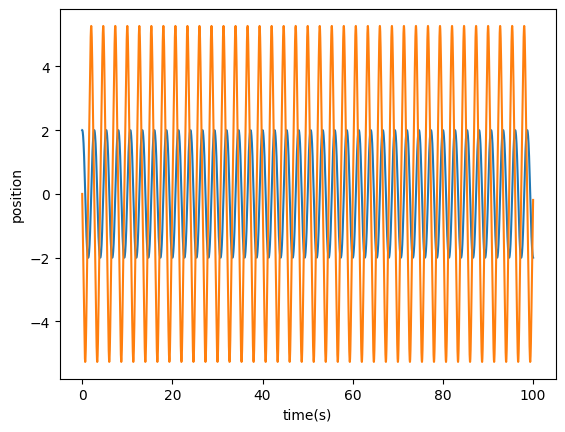

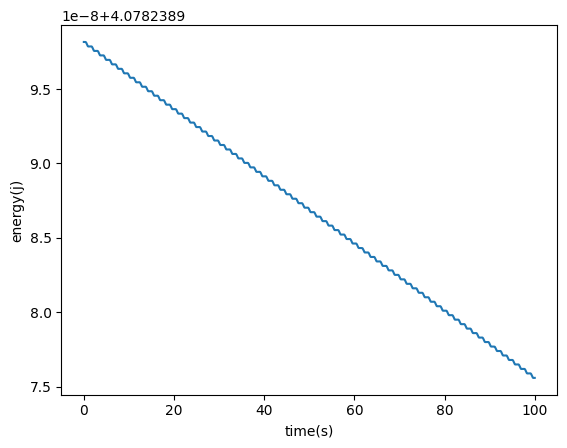

E-start: 4.078238998161996 E-end: 4.078238975598707


In [511]:
def df(t, thetavec, g, l):
    theta, thetadot = thetavec
    return [thetadot, -(g/l) * np.sin(theta)]

g=9.8
l=1
thetainit=2.0
solution = solve_ivp(df, [0., 10000*0.01], [thetainit, 0.], max_step = 0.01, args=(g,l))

plt.plot(solution.t, solution.y[0],label="int-position")
plt.plot(solution.t, solution.y[1],label="int-velocity")
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

energypos=energy(solution.y.T)
#e = 0.5 * m * solution.y[1]**2 + 0.5 * k * solution.y[0]**2
plt.plot(solution.t, energypos)
plt.xlabel("time(s)")
plt.ylabel("energy(j)")
plt.show()

print("E-start:",energypos[1],"E-end:",energypos[-1])

These integrals are known as **Elliptic Functions** this is the actual solution to the pendulum. As we have seen above this deviates from the normal harmonic oscillator. 

Now that we have made it to most sophisticated integrator, lets try to make our differential equation, progressively more complicated. Let's modify our differential equation to have a damped harmonic oscillator. 

$$
m\ell\ddot{\theta} = -m g\sin\theta - \mu\dot{\theta} + F \cos \Omega t \\
\ddot{\theta} =  -\frac{g}{\ell}\sin\theta - \frac{\mu}{m\ell}\dot{\theta} + \frac{F}{m\ell} \cos \Omega t \\
\ddot{\theta} = - \frac{g}{\ell}\sin\theta - \mu^{\prime}\dot{\theta} + f^{\prime} \cos \Omega t \\
$$

Ok let's go ahead and run this. 


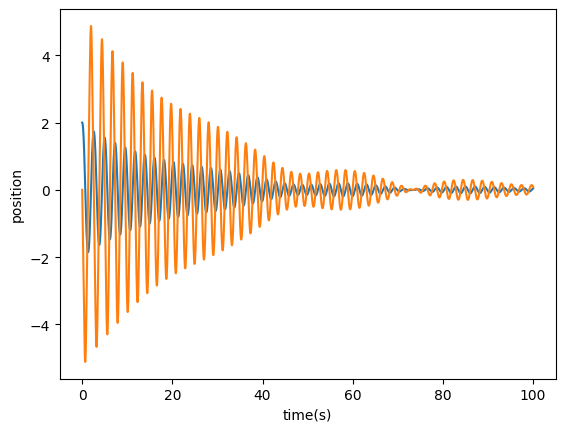

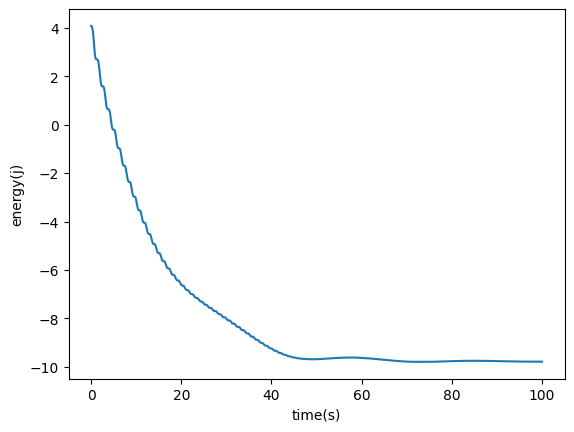

E-start: 4.07823899248926 E-end: -9.787953005826653


In [521]:
def df(t, thetavec, g, l, mup, fp, omega):
    theta, thetadot = thetavec
    return [thetadot, -(g/l) * np.sin(theta) - mup*thetadot + fp*np.cos(omega*t) ]

g=9.8
l=1
thetainit=2.0
mu=0.1
fp=0.1
omega=np.sqrt(0.85*g/l)
solution = solve_ivp(df, [0., 10000*0.01], [thetainit, 0.], max_step = 0.01, args=(g,l,mu,fp,omega))

plt.plot(solution.t, solution.y[0],label="int-position")
plt.plot(solution.t, solution.y[1],label="int-velocity")
plt.xlabel("time(s)")
plt.ylabel("position")
plt.show()

energypos=energy(solution.y.T)
#e = 0.5 * m * solution.y[1]**2 + 0.5 * k * solution.y[0]**2
plt.plot(solution.t, energypos)
plt.xlabel("time(s)")
plt.ylabel("energy(j)")
plt.show()

print("E-start:",energypos[1],"E-end:",energypos[-1])

Now, we can also plot a phase diagram defined as the velocity vs the position. We can define this as the velocity on the y-axis and the position on the x-axis. 

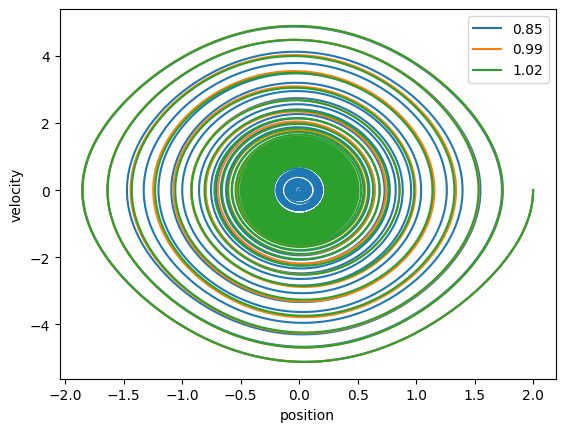

In [524]:
thetainit=2.0
mu=0.1
fp=0.1
l=1

omega=np.sqrt(0.99*g/l)
solution1 = solve_ivp(df, [0., 10000*0.01], [thetainit, 0.], max_step = 0.01, args=(g,l,mu,fp,omega))

omega=np.sqrt(1.02*g/l)
solution2 = solve_ivp(df, [0., 10000*0.01], [thetainit, 0.], max_step = 0.01, args=(g,l,mu,fp,omega))

plt.plot(solution.y[0], solution.y[1],label="0.85")
plt.plot(solution1.y[0], solution1.y[1],label="0.99")
plt.plot(solution2.y[0], solution2.y[1],label="1.02")
plt.xlabel("position")
plt.ylabel("velocity")
plt.legend()
plt.show()


The beauty of this is that with such a fast solution, we can start to look at properties of this differential equation. This allows us to look at the properties of the differential equation. 

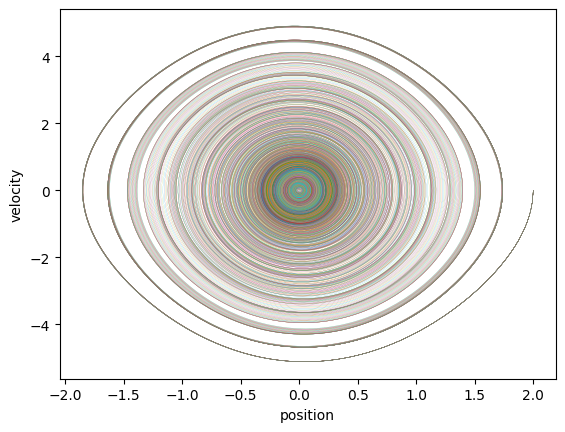

In [525]:
for scale in np.arange(0.8,1.20,0.01):
    omega=np.sqrt(scale*g/l)
    solution = solve_ivp(df, [0., 10000*0.01], [thetainit, 0.], max_step = 0.01, args=(g,l,mu,fp,omega))
    plt.plot(solution.y[0], solution.y[1],label="int-position",linewidth=0.1)

#for scale in np.arange(0.8,1.2,0.01):
plt.xlabel("position")
plt.ylabel("velocity")
plt.show()


<a name='section_15_3'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.6 Fitting the full thing </h2>  


Now that we have gone through the full numerical simulation of the pendulum, we wanted to go ahead and analyze some data to see how everything is behaving. To do this we will rely on some detailed pendulum data taken with a video camera using a tracking equipment. 

This data was kindly obtained from MIT undergraduates Kiran Mak, and Jade Chongsathapornpong. The data consits fo two pendulums one of length $4.151\pm0.007$m, and anothe rof length $10.7886\pm0.003$m. The data was digitzed using a tracking system and that takes the center through a Hough Transform. 

Let's take a look a tthe data first. To avoid issuds with the amplitude, we will normalize everything such that the max and min amplitude is at $1$. 


### Fitting our Pendulum simulation

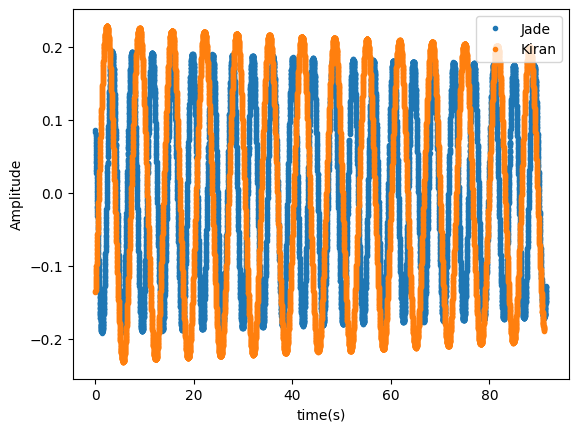

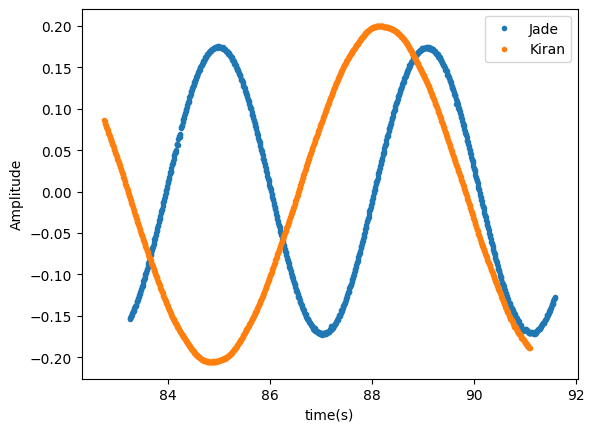

In [526]:
#Jade & Kiran
def load(iFile='data/jade-pendulum.csv'):
    times=np.array([])
    amps =np.array([])
    with open(iFile, newline='') as csvfile:
        line = csv.reader(csvfile, delimiter=' ', quotechar='|')
        for row in line:
            #print(', '.join(row))
            pT=float(row[0])
            pA=float(row[1])
            times=np.append(pT,times)
            amps =np.append(pA,amps)
    #Transform
    #times = times-times[0]
    amps  = (amps-amps.mean())/(2.*np.max(amps))
    return times,amps

tk,ak=load('data/Kiran.csv')
tj,aj=load()


plt.plot(tj,aj,'.',label='Jade')
plt.plot(tk,ak,'.',label='Kiran')
plt.xlabel('time(s)')
plt.ylabel("Amplitude")
plt.legend()
plt.show()

plt.plot(tj[0:1000],aj[0:1000],'.',label='Jade')
plt.plot(tk[0:1000],ak[0:1000],'.',label='Kiran')
plt.xlabel('time(s)')
plt.ylabel("Amplitude")
plt.legend()
plt.show()

Now before we really get into the nitty gritty of modeling this data. Let's go ahead and take a look at the data resolution to understand the fluctuations and the quality of the fit that we can get from this. To do that lets zoom into a few regions of the data. 

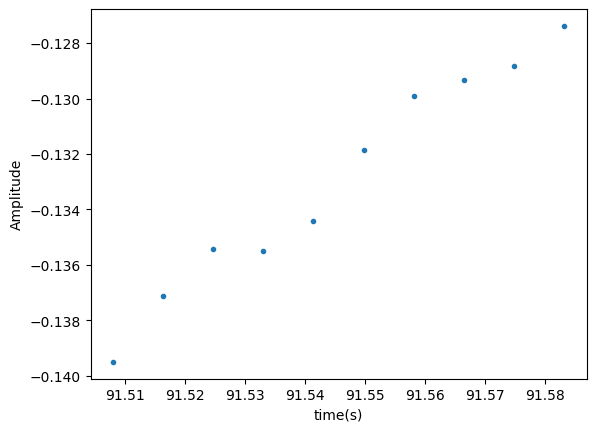

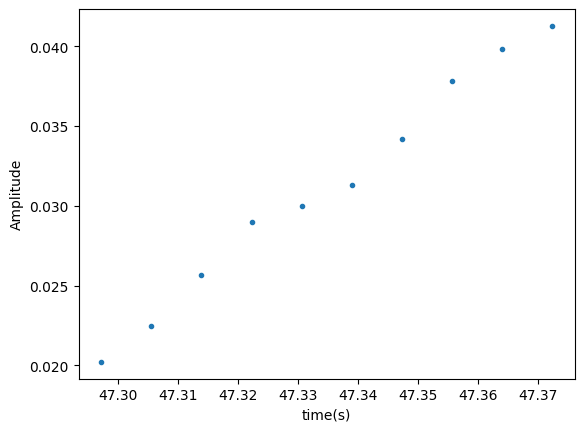

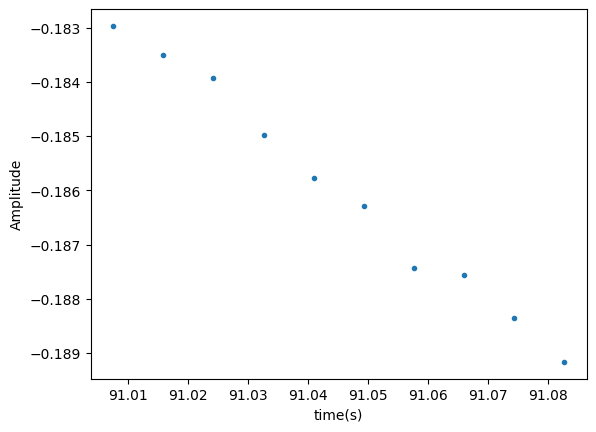

In [527]:
plt.plot(tj[0:10],aj[0:10],'.',label='Jade')
plt.xlabel('time(s)')
plt.ylabel("Amplitude")
plt.show()

plt.plot(tj[5300:5310],aj[5300:5310],'.',label='Jade')
plt.xlabel('time(s)')
plt.ylabel("Amplitude")
plt.show()

plt.plot(tk[0:10],ak[0:10],'.',label='Kiran')
plt.xlabel('time(s)')
plt.ylabel("Amplitude")
plt.show()


Now from the variation of the points, we can take an uncertainty of roughly $\sigma=2\times10^{-4}$ in amplitude units. We can be a bit more formal about this and fit a line and look at the $\chi^{2}$. 

[[Model]]
    Model(linear)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 10
    # data points      = 10
    # variables        = 2
    chi-square         = 8.05196856
    reduced chi-square = 1.00649607
    Akaike info crit   = 1.83331510
    Bayesian info crit = 2.43848528
    R-squared          = -197124.440
[[Variables]]
    slope:     -0.08401966 +/- 0.00264823 (3.15%) (init = 1)
    intercept:  7.46358263 +/- 0.24110886 (3.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(slope, intercept) = -1.000


/Users/philipharris/miniconda3/lib/python3.10/site-packages/lmfit/model.py:994: UserWarning: The keyword argument pars does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


<AxesSubplot: title={'center': 'Model(linear)'}, xlabel='x', ylabel='y'>

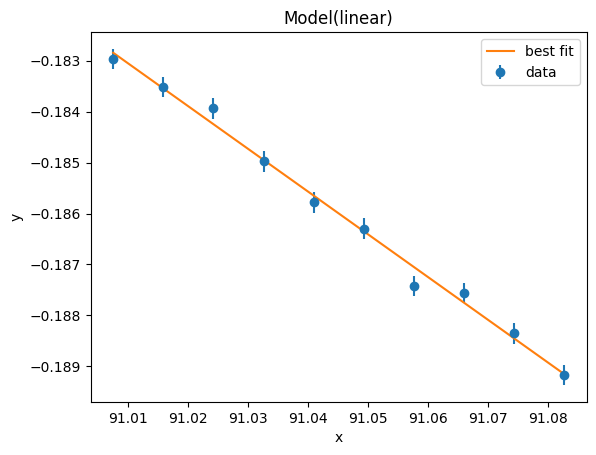

In [528]:
from lmfit import Model, Parameter, report_fit, fit_report
from lmfit.models import LinearModel

model = LinearModel()
pars = model.make_params(intercept=0, slope=0)
result=model.fit(x=tk[0:10],data=ak[0:10],pars=pars,weights=1./(np.ones(10)*2e-4))
print(result.fit_report())
result.plot_fit()

#plt.plot(tk[0:10],ak[0:10],'.',label='Kiran')
#plt.xlabel('time(s)')
#plt.ylabel("Amplitude")
#plt.show()


Ok good. We should keep in mind that there might be jumps in the data that will make it hard to fit. 

Now what we need to do is define our fit function, lets go ahead and do that and fit it on a short piece of data. 

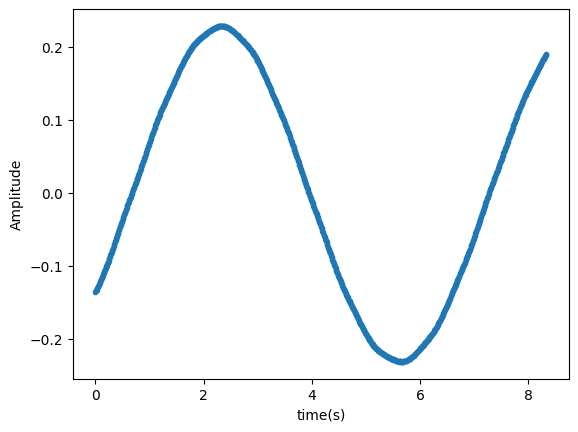

[[Model]]
    Model(func)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 1644
    # data points      = 1000
    # variables        = 6
    chi-square         = 28708.6671
    reduced chi-square = 28.8819589
    Akaike info crit   = 3369.19907
    Bayesian info crit = 3398.64560
    R-squared          = -1248.83817
[[Variables]]
    x0: -0.00523869 +/- 0.75931129 (14494.31%) (init = -0.01)
    x1:  0.00685850 +/- 0.99409883 (14494.41%) (init = 0.01)
    x2:  9.76595714 +/- 0.02430166 (0.25%) (init = 9.8)
    x3:  0.00519418 +/- 5.1094e-04 (9.84%) (init = 0)
    x4:  25.9402489 +/- 3758.12464 (14487.62%) (init = 15)
    x5: -0.00319798 +/- 5.4982e-05 (1.72%) (init = 0.01)
[[Correlations]] (unreported correlations are < 0.100)
    C(x1, x4) = -1.000
    C(x0, x1) = -1.000
    C(x0, x4) = 1.000
    C(x0, x2) = -0.998
    C(x2, x4) = -0.998
    C(x1, x2) = 0.998
    C(x2, x3) = 0.890
    C(x1, x3) = 0.887
    C(x0, x3) = -0.887
    C(x3, x4) = -0.887
    C(x3, 

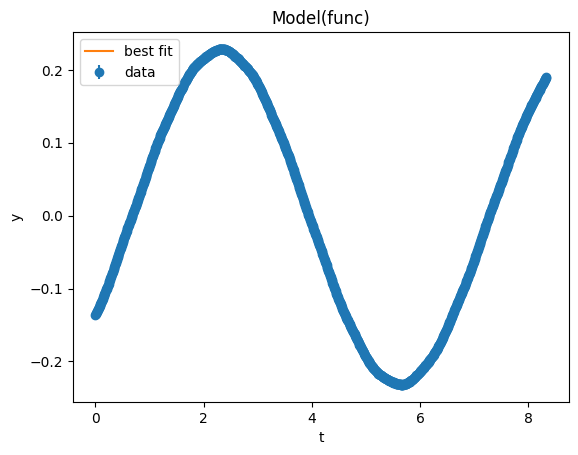

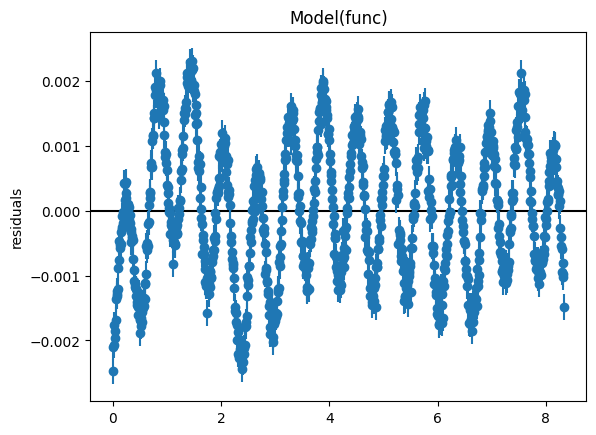

In [535]:
time=np.flip(tk)[0:1000]
amp= np.flip(ak)[0:1000]
weights=1.0/(np.ones(len(amp))*2*1e-4)
lk = 10.7886
lj = 4.151
l=lk

def ffull(y, t, g, l, mu): #This is for ODE
    theta, thetadot = y
    return [thetadot, - (g / l) * np.sin(theta)-mu*thetadot]

#def ffull(t, thetavec, g, l, mup): #This is for IVP
#    theta, thetadot = thetavec
#    return [thetadot, -(g/l) * np.sin(theta) - mup*thetadot  ]

def func(t,x0,x1,x2,x3,x4,x5):
    #solution = solve_ivp(ffull,[time[0],time[-1]], [x0, x1], max_step = 0.1, args=(x2,l,x3),t_eval=t)
    #solution = x4*solution.y[0]+x5#np.sin(solution[:,0])+x[5]
    solution = odeint(ffull, [x0,x1,], t, args=(x2,l,x3))
    solution = x4*solution[:,0]+x5#np.sin(solution[:,0])+x[5]
    return solution

#famp=func(time,-0.01,0.01,9.8,0.0,15,0.01)
plt.plot(time,amp,'.',label='Kiran')
#plt.plot(time,famp,label='func')
plt.xlabel('time(s)')
plt.ylabel("Amplitude")
plt.show()

xtest = np.array([-0.01,0.01,9.8,0.0,15,0.01])
model = Model(func, independent_vars=['t'])
params = model.make_params()
params['x0'].min=np.min(amp)*2
params['x0'].max=np.max(amp)*2
params['x1'].min=np.min(amp)*10
params['x1'].max=np.max(amp)*10
params['x2'].min=9.5
params['x2'].max=10.0
params['x3'].min=-0.1
params['x3'].max=0.1
params['x4'].min=1
params['x4'].max=100
#params['x4'].vary=False
params['x5'].min=-0.1
params['x5'].max=0.1
#params['x6'].min=-0.5
#params['x6'].max=0.5
#params['x6'].vary=False
result = model.fit(amp, t=time,params=params, weights=weights,
                  x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[4],x5=xtest[5])
print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()


Alright, so we have achieved a good fit, but look t the residuals. You can see there is a very clear jitter. My guess it that this is the interpolation between various points. There are a few ways to handle this. However, probably the easiest for now is to just sample less points since they all seem to be correlated. Let's now fit a much longer stretch of data, sampling every 10th event. 

[[Model]]
    Model(func)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 82
    # data points      = 500
    # variables        = 6
    chi-square         = 564.810089
    reduced chi-square = 1.14334026
    Akaike info crit   = 72.9407254
    Bayesian info crit = 98.2283739
    R-squared          = -45.3079130
[[Variables]]
    x0: -0.00511218 +/- 0.01814898 (355.01%) (init = -0.01)
    x1:  0.00669278 +/- 0.02379387 (355.52%) (init = 0.01)
    x2:  9.76149866 +/- 6.4738e-04 (0.01%) (init = 9.8)
    x3:  0.00297795 +/- 4.1803e-05 (1.40%) (init = 0)
    x4:  26.4660848 +/- 94.0526506 (355.37%) (init = 15)
    x5: -0.00306221 +/- 3.8407e-05 (1.25%) (init = 0.01)
[[Correlations]] (unreported correlations are < 0.100)
    C(x1, x4) = -1.000
    C(x0, x4) = 1.000
    C(x0, x1) = -1.000
    C(x0, x2) = -0.782
    C(x2, x4) = -0.782
    C(x1, x2) = 0.782
    C(x2, x3) = 0.105
    C(x0, x3) = -0.101
    C(x1, x3) = 0.101
    C(x3, x4) = -0.100


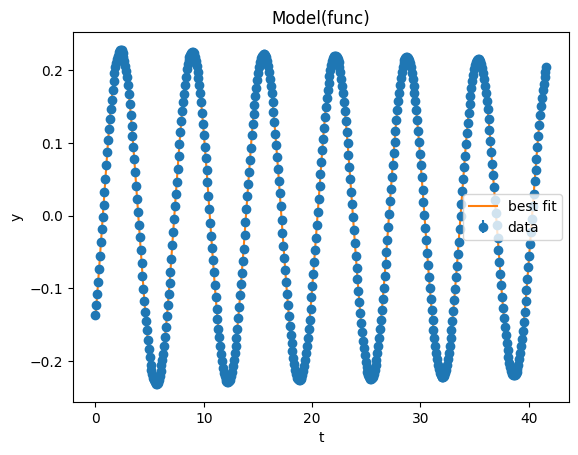

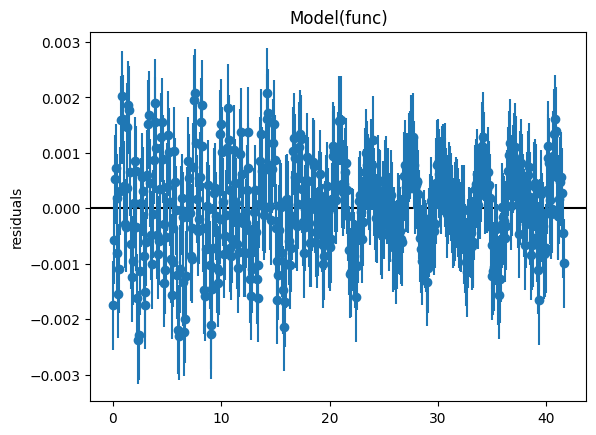

In [536]:
time=np.flip(tk)[0:5000][::10]
amp= np.flip(ak)[0:5000][::10]
weights=1/(np.ones(len(amp))*8*1e-4) #inflate uncertainty
lk = 10.7886
lj = 4.151
l=lk
result = model.fit(amp, t=time,params=params, weights=weights,
                  x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[4],x5=xtest[5])
print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()



Now, this data is not a perfect pendulum, thats clear. There are going to be biases. In particular, at the beginning of the pendulum, we could have additional oscillations. These are hard to take care of in this setup, so what we can do is just skip this part of the data. Also, after some playing, we relized that there is a bit of redundancy in teh fit, so we fixt $x_{4}=20$. 

Lets go ahead and look at the data. Let's also look at Kiran and Jade's data and see which one looks better. 

[[Model]]
    Model(func)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 31
    # data points      = 250
    # variables        = 5
    chi-square         = 263.508679
    reduced chi-square = 1.07554563
    Akaike info crit   = 23.1563471
    Bayesian info crit = 40.7636517
    R-squared          = -46.6406093
[[Variables]]
    x0:  0.01053889 +/- 7.5180e-06 (0.07%) (init = -0.01)
    x1:  0.00228810 +/- 7.2022e-06 (0.31%) (init = 0.01)
    x2:  9.76080135 +/- 6.0948e-04 (0.01%) (init = 9.8)
    x3:  0.00285977 +/- 5.8480e-05 (2.04%) (init = 0)
    x4:  20 (fixed)
    x5: -0.00295026 +/- 5.2681e-05 (1.79%) (init = 0.01)
[[Correlations]] (unreported correlations are < 0.100)
    C(x1, x2) = 0.852
    C(x0, x3) = 0.838
    C(x0, x2) = -0.251
    C(x0, x1) = -0.102


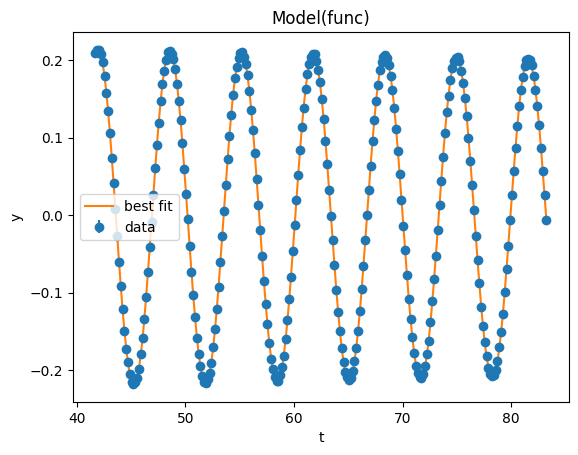

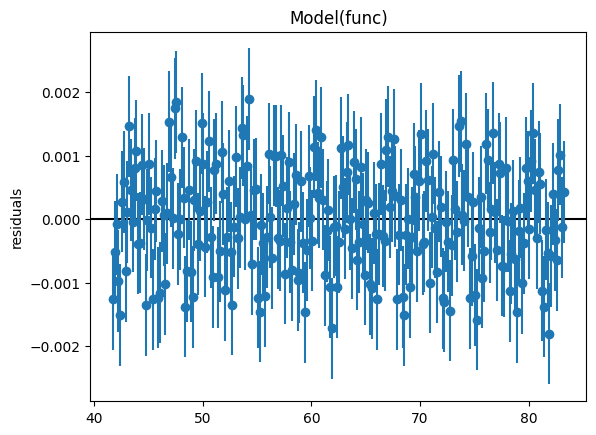

[[Model]]
    Model(func)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 37
    # data points      = 250
    # variables        = 5
    chi-square         = 397.579299
    reduced chi-square = 1.62277265
    Akaike info crit   = 125.983373
    Bayesian info crit = 143.590677
    R-squared          = -97.7158426
[[Variables]]
    x0: -0.00729163 +/- 9.1554e-06 (0.13%) (init = -0.01)
    x1: -0.00849055 +/- 1.4328e-05 (0.17%) (init = 0.01)
    x2:  9.83558331 +/- 5.5753e-04 (0.01%) (init = 9.8)
    x3:  0.00253702 +/- 8.3165e-05 (3.28%) (init = 0)
    x4:  20 (fixed)
    x5:  0.00204814 +/- 6.4592e-05 (3.15%) (init = 0.01)
[[Correlations]] (unreported correlations are < 0.100)
    C(x1, x2) = -0.719
    C(x0, x3) = -0.671
    C(x0, x2) = 0.531
    C(x1, x3) = -0.486


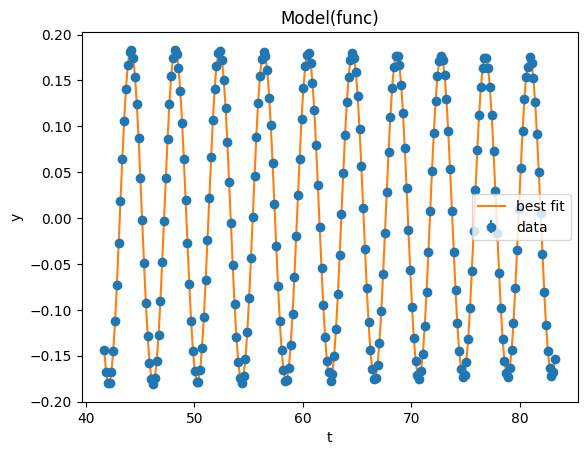

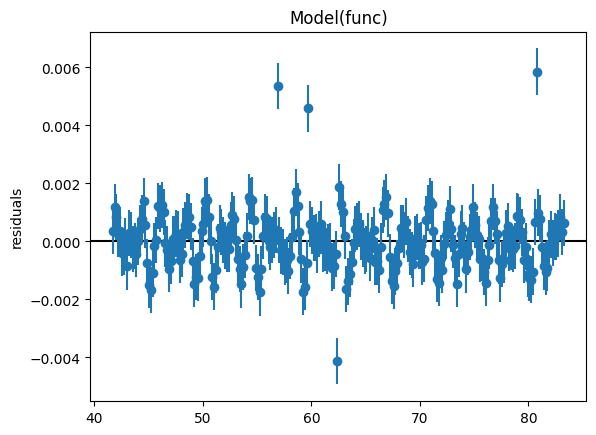

In [539]:
time=np.flip(tk)[5000:10000][::20]
amp= np.flip(ak)[5000:10000][::20]
weights=1/(np.ones(len(amp))*8*1e-4) #inflate uncertainty
lk = 10.7886
lj = 4.151
l=lk
xtest[4]=20
params['x4'].vary=False
result = model.fit(amp, t=time,params=params, weights=weights,
                  x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[4],x5=xtest[5])
print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()

time=np.flip(tj)[5000:10000][::20]
amp= np.flip(aj)[5000:10000][::20]
weights=1/(np.ones(len(amp))*8*1e-4) #inflate uncertainty
lk = 10.7886
lj = 4.151
l=lj
xtest[4]=20
params['x4'].vary=False
result = model.fit(amp, t=time,params=params, weights=weights,
                  x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[4],x5=xtest[5])

print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()



Now, lets update our fit function to be even more sophisticated, to capture real like. What we can do is an addition to addin the damping friction $F=-\mu\ell\dot{\theta}$ we can add the drag force as well, this gives us a force of $F
=-k\dot{\theta}^2$. Let's go ahead and do that and see how our function performs. 

In [540]:
def ffull(y, t, g, l, mu, drag): #This is for ODE
    theta, thetadot = y
    return [thetadot, - (g / l) * np.sin(theta)-mu*thetadot-drag*thetadot**2 ]

#def ffull(t, thetavec, g, l, mup): #This is for IVP
#    theta, thetadot = thetavec
#    return [thetadot, -(g/l) * np.sin(theta) - mup*thetadot  ]

def func(t,x0,x1,x2,x3,x4,x5,x6):
    #solution = solve_ivp(ffull,[time[0],time[-1]], [x0, x1], max_step = 0.1, args=(x2,l,x3),t_eval=t)
    #solution = x4*solution.y[0]+x5#np.sin(solution[:,0])+x[5]
    solution = odeint(ffull, [x0,x1,], t, args=(x2,l,x3,x6))
    solution = (x4*solution[:,0]+x5)#*(1-x7*np.cos(solution[:,0]))
    return solution


xtest = np.array([-0.01,0.01,9.8,0.0,20,0.01,0.0,0])
model = Model(func, independent_vars=['t'])
params = model.make_params()
params['x0']
params['x0'].min=np.min(amp)
params['x0'].max=np.max(amp)
params['x1'].min=np.min(amp)*10
params['x1'].max=np.max(amp)*10
params['x2'].min=9.5
params['x2'].max=10.0
params['x3'].min=-0.1
params['x3'].max=0.1
params['x4'].min=1
params['x4'].max=100
params['x4'].vary=False
params['x5'].min=-0.1
params['x5'].max=0.1
params['x6'].min=-10.5
params['x6'].max=10.5
#params['x7'].min=-0.1
#params['x7'].max=0.1
#params['x6'].vary=False


[[Model]]
    Model(func)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 50
    # data points      = 1000
    # variables        = 6
    chi-square         = 928.231560
    reduced chi-square = 0.93383457
    Akaike info crit   = -62.4740514
    Bayesian info crit = -33.0275197
    R-squared          = -38.9381780
[[Variables]]
    x0: -0.00668450 +/- 6.2447e-06 (0.09%) (init = -0.01)
    x1:  0.00880306 +/- 4.8617e-06 (0.06%) (init = 0.01)
    x2:  9.76170531 +/- 1.5332e-04 (0.00%) (init = 9.8)
    x3:  0.00288775 +/- 1.3428e-05 (0.47%) (init = 0)
    x4:  20 (fixed)
    x5: -0.00438130 +/- 1.0233e-04 (2.34%) (init = 0.01)
    x6: -1.17417426 +/- 0.08495227 (7.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(x5, x6) = 0.971
    C(x0, x6) = -0.828
    C(x0, x5) = -0.805
    C(x1, x6) = 0.719
    C(x1, x5) = 0.693
    C(x1, x2) = -0.638
    C(x0, x1) = -0.607
    C(x1, x3) = 0.529
    C(x2, x6) = -0.479
    C(x2, x5) = -0.460
   

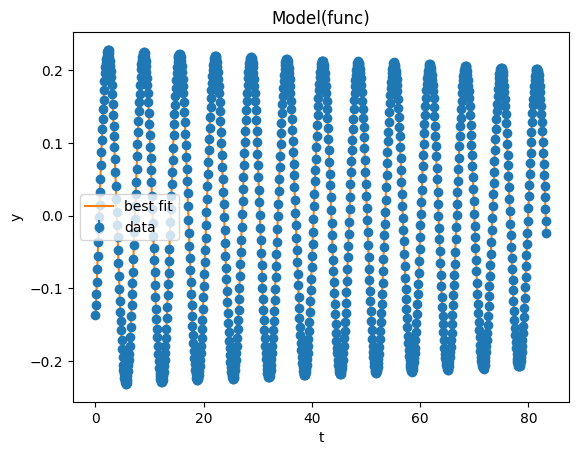

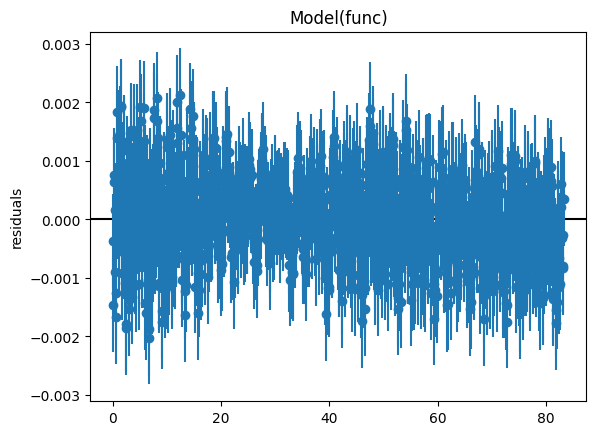

[[Model]]
    Model(func)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 139
    # data points      = 500
    # variables        = 6
    chi-square         = 509.526584
    reduced chi-square = 1.03143033
    Akaike info crit   = 21.4369646
    Bayesian info crit = 46.7246132
    R-squared          = -62.2246562
[[Variables]]
    x0: -0.00738954 +/- 3.9154e-06 (0.05%) (init = -0.01)
    x1: -0.00857940 +/- 3.5527e-06 (0.04%) (init = 0.01)
    x2:  9.83691012 +/- 2.9450e-04 (0.00%) (init = 9.8)
    x3:  0.00250823 +/- 8.7188e-06 (0.35%) (init = 0)
    x4:  20 (fixed)
    x5:  0.00378431 +/- 3.8343e-05 (1.01%) (init = 0.01)
    x6:  2.17055075 +/- 0.00129379 (0.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(x2, x3) = -0.962
    C(x0, x3) = -0.819
    C(x0, x2) = 0.759
    C(x0, x1) = -0.700
    C(x1, x2) = -0.609
    C(x1, x3) = 0.512
    C(x1, x6) = 0.483
    C(x2, x6) = -0.397
    C(x5, x6) = 0.163
    C(x3, x6) = 0.135
    C(

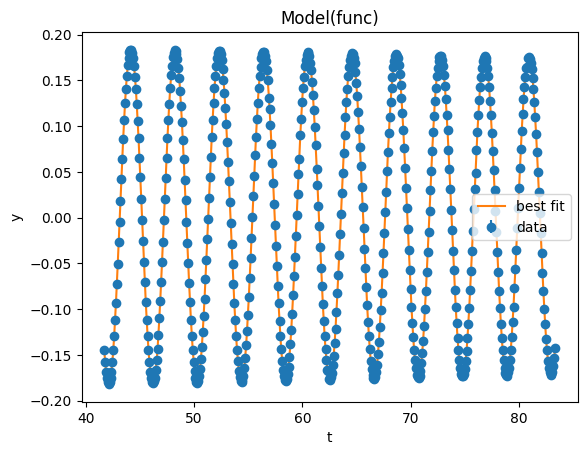

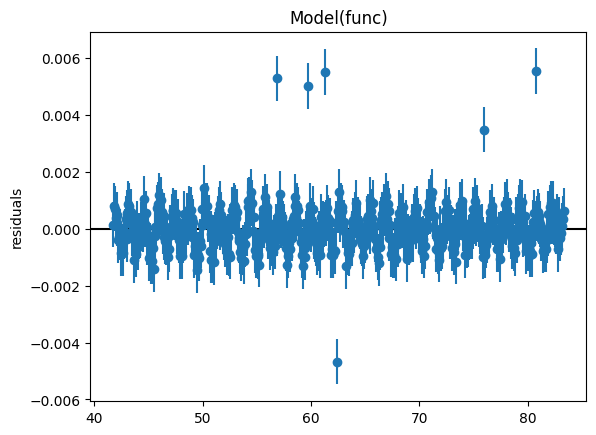

9.80348820582177

In [544]:
time=np.flip(tk)[0:10000][::10]
amp= np.flip(ak)[0:10000][::10]
weights=1/(np.ones(len(amp))*8*1e-4) #inflate uncertainty
lk = 10.7886
lj = 4.151
l=lk
xtest[4]=20
params['x4'].vary=False
result = model.fit(amp, t=time,params=params, weights=weights,
                  x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[4],x5=xtest[5],x6=xtest[6])#,x7=xtest[7])
print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()

time=np.flip(tj)[5000:10000][::10]
amp= np.flip(aj)[5000:10000][::10]
weights=1/(np.ones(len(amp))*8*1e-4) #inflate uncertainty
lk = 10.7886
lj = 4.151
l=lj
xtest[4]=20
params['x4'].vary=False
result = model.fit(amp, t=time,params=params, weights=weights,
                  x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[4],x5=xtest[5],x6=xtest[6])#,x7=xtest[7])

print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()

def gtrue(phi):
    return 9.80616-0.025925*np.cos(2*phi)+0.000069*np.cos(phi)**2

gtrue(42./180.*np.pi)


Let's take a look at our results for the best fit value of $g$. For this, we get

$g=9.7616\pm0.0002$, and $g=9.8378\pm0.0005$

If we average them we get $g=9.8000$, which is pretty close to the best fit at the latitute of Boston $g=9.8034$. That being said, there are a number of effects, which haven't propagated to the measurement that could probably get us even more precise. In particular, the measurement of the pendulum length $\ell$, the addition of the pendulum's moment of inertia. All of thesse are at the level of a fraction of a percent, which is much higher than the fit precision we have already obtained. 

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.6.1 </span>

Repeat the fit with just the damped harmonic oscillator solution, how does this impact the measurement of $g$?

[[Model]]
    Model(dampfunc)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 93
    # data points      = 1000
    # variables        = 5
    chi-square         = 1105.91615
    reduced chi-square = 1.11147352
    Akaike info crit   = 110.674086
    Bayesian info crit = 135.212862
    R-squared          = -46.5832518
[[Variables]]
    x0: -0.22982590 +/- 7.8775e-05 (0.03%) (init = -0.01)
    x1:  2.51304900 +/- 3.3339e-04 (0.01%) (init = 0.01)
    x2:  9.76098622 +/- 1.4691e-04 (0.00%) (init = 9.8)
    x3:  0.00144986 +/- 7.3338e-06 (0.51%) (init = 0)
    x4: -0.00300788 +/- 2.6694e-05 (0.89%) (init = 0.01)
[[Correlations]] (unreported correlations are < 0.100)
    C(x0, x3) = -0.860
    C(x1, x2) = -0.854


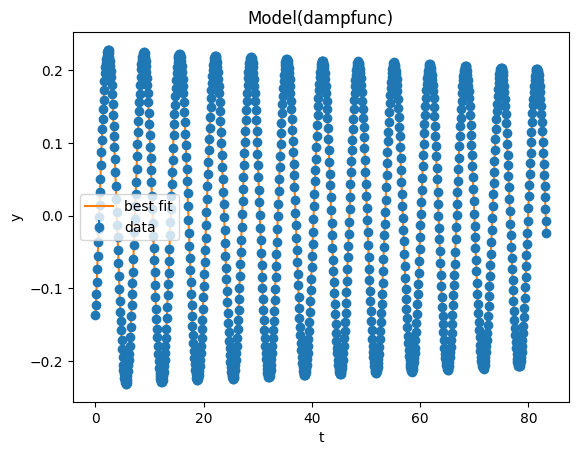

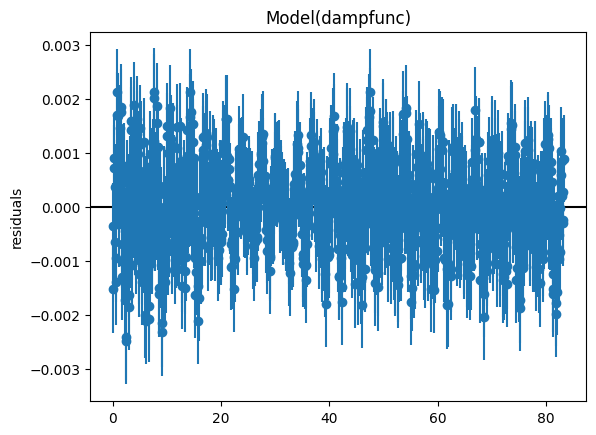

[[Model]]
    Model(dampfunc)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 127
    # data points      = 1000
    # variables        = 5
    chi-square         = 1343126.98
    reduced chi-square = 1349.87636
    Akaike info crit   = 7212.75574
    Bayesian info crit = 7237.29452
    R-squared          = -80234.3979
[[Variables]]
    x0: -0.17918797 +/- 0.00263553 (1.47%) (init = -0.01)
    x1: -6.28318531 +/- 0.01424170 (0.23%) (init = 0.01)
    x2:  9.73167974 +/- 0.00351877 (0.04%) (init = 9.8)
    x3:  1.5688e-04 +/- 3.0567e-04 (194.84%) (init = 0)
    x4:  0.00186975 +/- 9.2979e-04 (49.73%) (init = 0.01)
[[Correlations]] (unreported correlations are < 0.100)
    C(x0, x3) = -0.865
    C(x1, x2) = -0.829


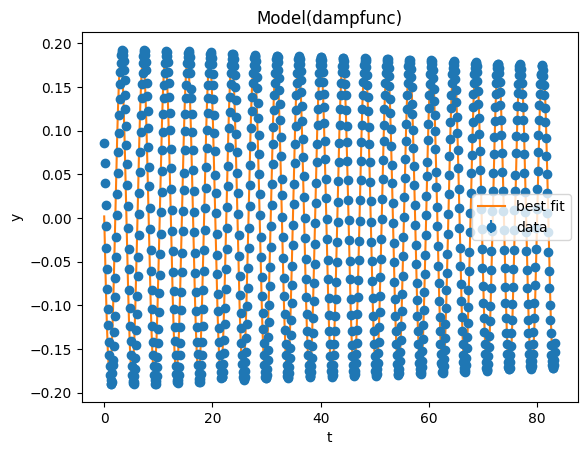

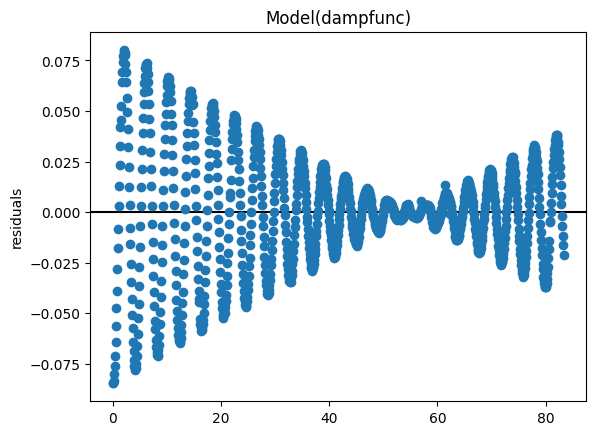

In [545]:
def dampfunc(t,x0,x1,x2,x3,x4):
    return x0*np.exp(-t*x3)*np.sin(np.sqrt(x2/l)*t+x1)+x4


dampmodel = Model(dampfunc, independent_vars=['t'])
params = dampmodel.make_params()
params['x0'].min=np.min(amp)*10
params['x0'].max=np.max(amp)*10
params['x1'].min=-2*np.pi
params['x1'].max=2*np.pi
params['x2'].min=9.5
params['x2'].max=10.0
params['x3'].min=-0.1
params['x3'].max=0.1
params['x4'].min=-0.1
params['x4'].max=0.1
#params['x4'].vary=False
#params['x5'].min=-0.1
#params['x5'].max=0.1
#params['x6'].min=-10.5
#params['x6'].max=10.5


time=np.flip(tk)[0:10000][::10]
amp= np.flip(ak)[0:10000][::10]
weights=1/(np.ones(len(amp))*8*1e-4) #inflate uncertainty
lk = 10.7886
lj = 4.151
l=lk
result = dampmodel.fit(amp, t=time,params=params, weights=weights,
                      x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[5])
print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()

time=np.flip(tj)[0:10000][::10]
amp= np.flip(aj)[0:10000][::10]
weights=1/(np.ones(len(amp))*8*1e-4) #inflate uncertainty
lk = 10.7886
lj = 4.151
l=lj
result = dampmodel.fit(amp, t=time,params=params, weights=weights,
                      x0=xtest[0],x1=xtest[1],x2=xtest[2],x3=xtest[3],x4=xtest[5])

print(result.fit_report())
result.plot_fit()
plt.show()
result.plot_residuals()
plt.show()


<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
Best Fit paraterms are worse compared to the true $g$ value
</pre>
        
**EXPLANATION:**
The damped approximation solution dos not accoutn for allz orders, like the eleeptic function.  
    
</div>

<a name='section_15_2'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.7 Bifurcation diagrams and chaotic motion </h2>  



Now what we can do is define a bifurcation diagram using a driven damped harmonic oscillator. Bifurcatoin dynamics are used to describe chaotic motion like what we saw with the damped, driven pendulum. Before, we do that, lets create the most famous bifrucation diagram.  In this map, we perform an iterative procedure whereby we define

$$x_{n+1} = r x_{n}(1-x_{n})$$

What we can then do is run the logistic regression and define a bifurcation diagram In this diagram, we plot the x-potision for the n-th iteration by varying a large number of $r$ values after starting at the exact same x-position.  

Text(0.5, 1.0, 'Bifurcation diagram')

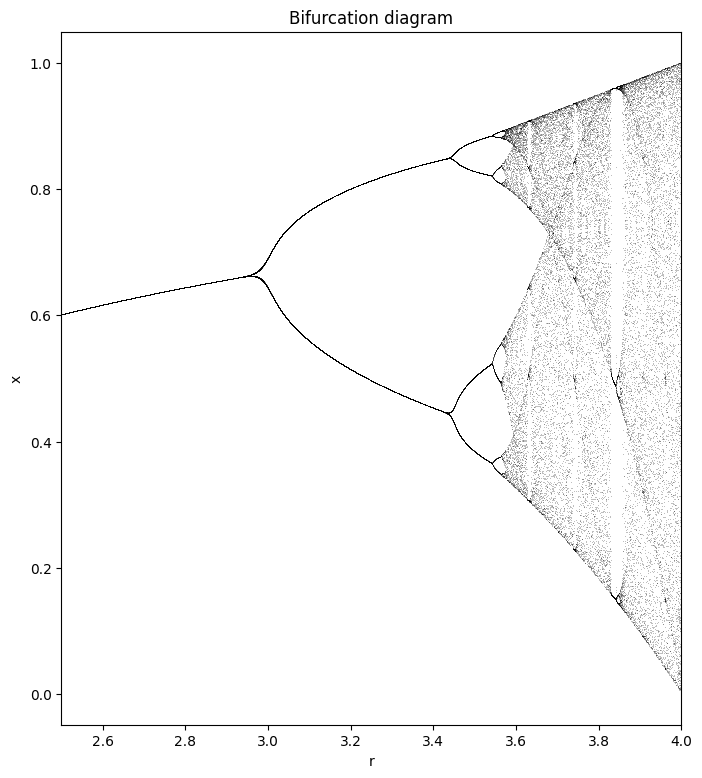

In [549]:
def logistic(r, x):
    return r * x * (1 - x)

iterations=100
last = 10
n = 10000
r = np.linspace(2.5, 4.0, n)
x = 1e-5 * np.ones(n)

fig, ax1 = plt.subplots(1, 1, figsize=(8, 9),sharex=True)
for i in range(iterations):
    x = logistic(r, x)   
    # We compute the partial sum of the
    # Lyapunov exponent.<a name='section_15_2'></a>
    #lyapunov += np.log(abs(r - 2 * r * x))
    # We display the bifurcation diagram.
    if i >= (iterations - last):
        ax1.plot(r, x, ',k', alpha=.25)
ax1.set_xlabel('r')
ax1.set_ylabel('x')
ax1.set_xlim(2.5, 4)
ax1.set_title("Bifurcation diagram")


Now given a simple formula, like above. Let's try to do the same thing with our numerically solved damped driven pendulum. Let'st start by making our pendulum a bit chaolotic, here are some variabls that give us what looks like chaotic motion. Let's go ahead an see how it looks. 

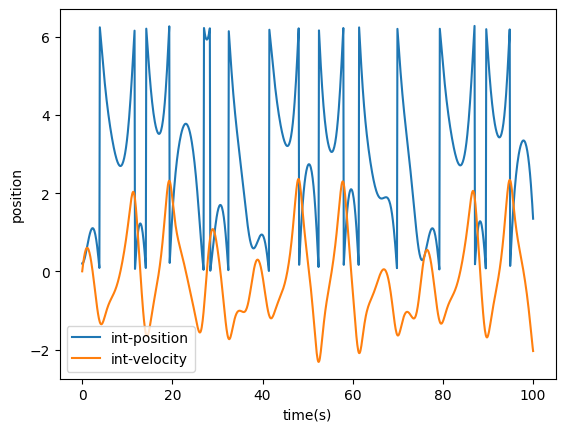

In [552]:

g=9.8
l=9.8
thetainit=0.2
mu=0.5
fp=1.2
omega=2./3.
solution = solve_ivp(df, [0., 100], [thetainit, 0.], max_step = 0.1, args=(g,l,mu,fp,omega))

plt.plot(solution.t, solution.y[0] % (2*np.pi),label="int-position")
plt.plot(solution.t, solution.y[1],label="int-velocity")
plt.xlabel("time(s)")
plt.ylabel("position")
plt.legend()
plt.show()


Now, one thing that is iteresting is to look at the variation of the oscillations over a period. The way we do this is by look at the sample points in the oscillation. For our plot, we will define stable points as points where the velocity is zero. 

/var/folders/4t/mwl83f3x1ls0jvy35v4qzj7c0000gp/T/ipykernel_27548/2211243863.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string ",k" (-> color='k'). The keyword argument will take precedence.
  plt.plot(fptrue*np.ones(len(crossings)), (solution.y[0][-1000:][crossings] % (2*np.pi)),',k',c='black')#, alpha=.25)


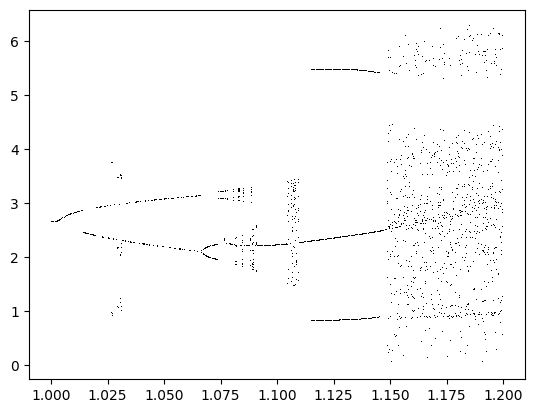

In [554]:
fp=1.0
thetainit=0.2
mu=0.5
g=9.8
l=9.8
omegad=2./3.
        
for scale in np.arange(1.0,1.2,0.0005):
    fptrue=fp*scale
    solution = solve_ivp(df, [0., 1000], [thetainit, 0.], max_step = 0.1, args=(g,l,mu,fptrue,omegad))
    #idx = (np.abs(solution.y[1][-100:])).argmin()
    #print(solution.y[1][-100:][1:] ,"A!!")
    #print(solution.y[1][-100:][:-1],"B!!")
    #print(solution.y[1][-100:][:-1]*solution.y[1][-100:][1:],"C!!")
    crossings = np.where((solution.y[1][-1000:][:-1]*solution.y[1][-1000:][1:]  <= 0) 
                         & (solution.y[1][-1000:][:-1] - solution.y[1][-1000:][1:] > 0)
                        )[0]
    plt.plot(fptrue*np.ones(len(crossings)), (solution.y[0][-1000:][crossings] % (2*np.pi)),',k',c='black')#, alpha=.25)
plt.show()

What is going on? What we are plotting are the regions where the pendulum is changing directions. You can see clearly that at sompoints there are two or 4 well define ends. Then you can see as we vary "f" longer, the number of stable points changes pretty dramatically to points where there is no clearly defined stable point at all. This is emblemnatic of pendulum dynamics. 

In the real world this type of motion is present in a lot of different physical scenarios. One classic example is that of Saturn's rings, which themselves are a damped driven harmonic oscillator if you take a slice of the dust revoling around Saturn. The flow of the dust pulls the other dust, and gravity pulls the dust closer. 

We can create a full setup of this without much work from what we have done. Out of this you can create the clumpy features and divisions of Saturns rings, such as the Cassini division. The field of Chaotic dynaics is rich, but requires highly adept integrators that can extrapolate over large regions. This is a critical component of the dynamics of future motion. 

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.7.1 </span>

Take a look at the above bifurcation diagram. Make a plot of position $\theta$ (x-xaxis) vs velocity $\dot{\theta}$ (y-axis) for a stable point with a clear set of stable points, and for a chotic region. What can you see? 

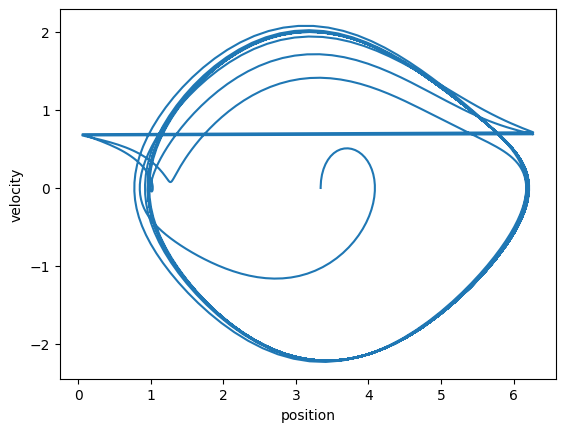

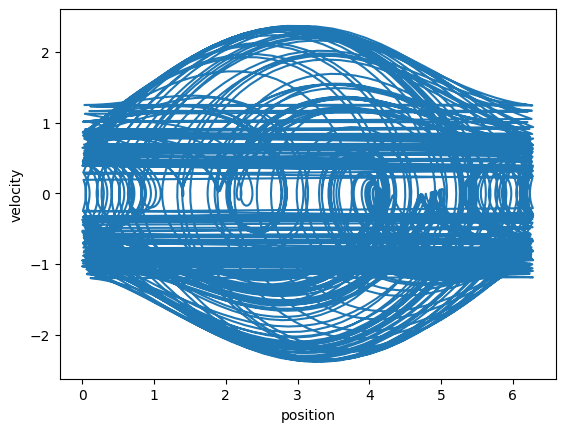

In [557]:
solution = solve_ivp(df, [0., 100000*0.01], [thetainit, 0.], max_step = 0.1, args=(g,l,mu,fp*1.05,omegad))
plt.plot((solution.y[0] + np.pi) % (2*np.pi), solution.y[1] ,label="int-position")
plt.xlabel("position")
plt.ylabel("velocity")
plt.show()

solution = solve_ivp(df, [0., 100000*0.01], [thetainit, 0.], max_step = 0.1, args=(g,l,mu,fp*1.22,omegad))
plt.plot((solution.y[0] + np.pi) % (2*np.pi), solution.y[1] ,label="int-position")
plt.xlabel("position")
plt.ylabel("velocity")
plt.show()



<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
One plot closely repeats itself, the other fills out the full phase space 
</pre>
        
**EXPLANATION:**
This defines the concept of "ergodicity" namely how much of the phase space is actually populated by the system. Ergotic motion fills out the full region, whereas non-ergoditc tends to stay at regular positions. 
    
</div>

<a name='section_15_9'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.8  Numerical precision and Chaotic Dynamics </h2>  


Now one final thing we can do is look at the performance with some of our more simpler integration methods. Let's do a quick comparison of the Poincare section plots $\dot{\theta}$ vs $\theta$ for different levels of precision.

For this, what we will do is run the leap-frog integrator on the same system, and we will try to gauge our overall performance compared to the IVP. We can do this for a stable scenario, and we can do it for an unstable scenario. Let's see what we get. 

[[ 0.00000000e+00  0.00000000e+00]
 [ 2.00000000e-01 -9.93346654e-04]
 [ 1.99990067e-01 -2.97497587e-03]
 ...
 [-2.10683927e+00  4.19444594e-01]
 [-2.10264482e+00  4.32200284e-01]
 [-2.09832282e+00  4.44970221e-01]]


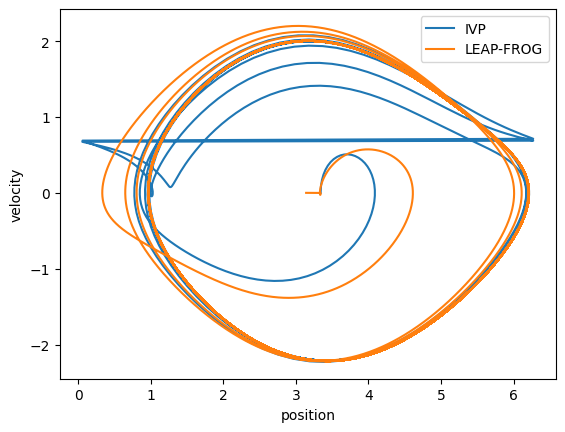

[[ 0.00000000e+00  0.00000000e+00]
 [ 2.00000000e-01 -9.93346654e-04]
 [ 1.99990067e-01 -2.97497587e-03]
 ...
 [-6.48517465e+00  8.03367974e-01]
 [-6.47714097e+00  8.07928368e-01]
 [-6.46906169e+00  8.12446553e-01]]


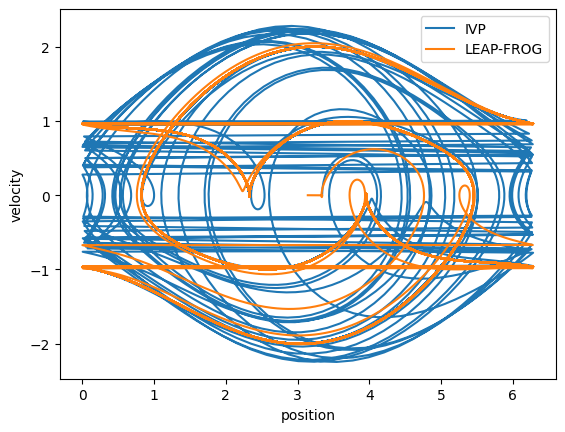

In [558]:
def store(theta,thetapos,time,timepos):
    thetapos = np.vstack((thetapos,theta))
    timepos  = np.vstack((timepos,time))
    return timepos,thetapos

def step(theta,t,dt,g,l,mu,f,omegad):
    theta[0] += theta[1] * dt 
    #theta[1] += (g/l)*(-1)*theta[0]*dt
    #print(((g/l)*(-1)*np.sin(theta[0])-mu*theta[1]+f*np.sin(omegad*t))*dt)
    theta[1] += ((g/l)*(-1)*np.sin(theta[0])-mu*theta[1]+f*np.sin(omegad*t))*dt
   
def loop(nsteps=1000,dt=0.01,g=9.8,l=9.8,mu=0.5,f=1.0,omegad=omegad):
    timepos  = np.zeros(1)
    thetapos = np.zeros((1,2));
    time     = 0
    theta    = np.zeros(2)
    theta[0] = thetainit #initial conditions
    theta[1] = 0.0
    theta[1] += ((g/l)*(-1)*np.sin(theta[0])-mu*theta[1]+f*np.sin(omegad*time))*dt*0.5
    timepos,thetapos=store(theta,thetapos,time,timepos)
    for timestep in range(nsteps):
        step(theta,time,dt,g,l,mu,f,omegad)
        time += dt
        timepos,thetapos=store(theta,thetapos,time,timepos)
    return timepos,thetapos

time,thetaout=loop(100000,dt=0.01,g=g,l=l,mu=mu,f=fp*1.05,omegad=omegad)
print(thetaout)
solution = solve_ivp(df, [0., 100000*0.01], [thetainit, 0.], max_step = 0.1, args=(g,l,mu,fp*1.05,omegad))
plt.plot((solution.y[0] + np.pi) % (2*np.pi), solution.y[1] ,label="IVP")
plt.plot((thetaout[:,0] + np.pi) % (2*np.pi), thetaout[:,1] ,label="LEAP-FROG")
plt.xlabel("position")
plt.ylabel("velocity")
plt.legend()
plt.show()

time,thetaout=loop(100000,dt=0.01,g=g,l=l,mu=mu,f=fp*1.12,omegad=omegad)
print(thetaout)
solution = solve_ivp(df, [0., 100000*0.01], [thetainit, 0.], max_step = 0.1, args=(g,l,mu,fp*1.12,omegad))
plt.plot((solution.y[0] + np.pi) % (2*np.pi), solution.y[1] ,label="IVP")
plt.plot((thetaout[:,0] + np.pi) % (2*np.pi), thetaout[:,1] ,label="LEAP-FROG")
plt.xlabel("position")
plt.ylabel("velocity")
plt.legend()
plt.show()

What you can see is that the leap-frog integrator is not as nearly as thorough as the IVP integrator. This doesn't come as a surprise since we know that the leapfrog integrator is only just an approximation of the full modern 1d integrators that are currently used. 

<a name='section_15_9'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.9 Machine Learning the pendulum </h2>  


Now that we have opened Pandora's box on deep learning, we can't go a lecture without discussing deep learning applications to everything. Deep learning for differential equations also has a very "Physicsy" moniker and is often called "Physics Informed Machine Learninng" (PIML) or sometimes "Physics Informed Neural Networks" (PINN). Ironically, the people who really pushed this are not physicists. 

The idea to do Physics Informed Machine Learning stems from the ability of neural networks to be function approximators. The simplest form is to do the same function style "fitting" that we did for the deep learning regression. However, what we can do is modify our loss with the knowledge of the differential equation. 

To seed the idea, let's consider modifying the loss with an additional term given by our differential equation. For a damped harmonic oscillator we can write: 

$$
F = -kx + \mu\dot{x} \\
m \ddot{x} = -kx - \mu\dot{x} \\
m \ddot{x} + mu\dot{x} +  kx  = 0 
$$
Which means that to approximate the differential equation, we can write a loss term as

$$
\mathcal{L_{\rm constrained}} = \left( m \ddot{x} + \mu\dot{x} +  kx \right)^2
$$
Which is just the unsigned residual of the differential equation. Now noting that we want to train for a neural network function $f(x|\theta)$, we can write: 
$$
\dot{x} = \frac{d}{dt}f(x|\theta) \\
\ddot{x} = \frac{d^{2}}{dt^{2}}f(x|\theta) 
$$
which we can presumably compute from the neural network. 

If we want to fit some data with this constraint embedded in it, we can then just write this as a combination of mean squared error with the constrained loss. 

$$
\mathcal{L} = \sum_{i} (x_{i}-f\left(t|\theta\right))^{2} + \mathcal{L_{\rm constrained}}
$$

Now the tricky part is doing the computation of the additional "constrained" loss term. This will require that we can take derivatives of the neural network. Before, we get to that point, lets do a little setup. 

To start with we, will do this experimentw ith some toy data generated off the damped harmonic oscillator form. The solution for this function is 

$$
x(t) = A e^{-\kappa t} \cos(\omega t + \phi) \\
\kappa = \frac{\mu}{2m} \\
\omega = \sqrt{\omega_{0}^2+\kappa^2} \\
\omega_{0} = \sqrt{\frac{k}{m}}
$$
with $\phi$ and $A$ as the phase an amplitude of our differential equation, that are set by the initial conditions ($A$ is intial position, $\phi$ is related to the initial velocity).  For the case where $x(0)=1$ and $\dot{x}=0$ we can write 
$$
\phi = \tan^{-1}\left(-\frac{\kappa}{\omega}\right) \\
A    = \frac{1}{2\cos(\phi)}
$$

Let's go ahead and code that up, also, lets make a neural network. 

In [555]:
def oscillator(d, w0, x):
    w = np.sqrt(w0**2-d**2)
    phi = np.arctan(-d/w)
    A = 1/(2*np.cos(phi))
    cos = torch.cos(phi+w*x)
    sin = torch.sin(phi+w*x)
    exp = torch.exp(-d*x)
    y  = exp*2*A*cos
    return y

class MLP(nn.Module):    
    def __init__(self, N_INPUT, N_OUTPUT, N_HIDDEN):
        super().__init__()
        activation = nn.Tanh
        self.input = nn.Sequential(
                        nn.Linear(N_INPUT, N_HIDDEN),
                        activation()
                      )
        self.hidden = nn.Sequential(
                    nn.Linear(N_HIDDEN, N_HIDDEN),
                    activation(),
                    nn.Linear(N_HIDDEN, N_HIDDEN),
                    activation(),
                    nn.Linear(N_HIDDEN, N_HIDDEN),
                    activation(),        
                    )

        self.output = nn.Linear(N_HIDDEN, N_OUTPUT)
        #self.fcs = nn.Sequential(*[nn.Linear(N_INPUT, N_HIDDEN),activation()])
        #self.fch = nn.Sequential(*[nn.Sequential(*[nn.Linear(N_HIDDEN, N_HIDDEN),activation()]) for _ in range(N_LAYERS-1)])
        #self.fce = nn.Linear(N_HIDDEN, N_OUTPUT)
        
    def forward(self, x):
        x = self.input(x)
        x = self.hidden(x)
        x = self.output(x)
        return x
    


Now, what we can do is make some toy data from our damped harmonic oscillator. To do this, we will generate this right in pytorch, which will make it easier to train and evulate going forward. In this instance we ill generate a precise dataset, then we will take just one event every 20th and run our evaluation on it. 

torch.Size([10, 1]) torch.Size([10, 1])


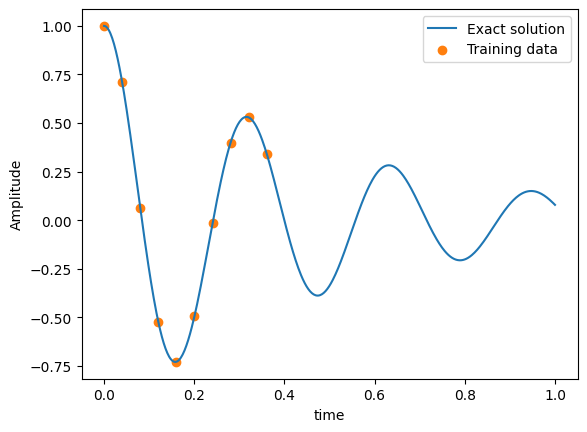

In [556]:
d, w0 = 2, 20

# get the analytical solution over the full domain
x = torch.linspace(0,1,500).view(-1,1)
y = oscillator(d, w0, x).view(-1,1)

# slice out a small number of points from the LHS of the domain
x_data = x[0:200:20] # take just one event every 20th from 0 to 200
y_data = y[0:200:20]
print(x_data.shape, y_data.shape)

plt.figure()
plt.plot(x, y, label="Exact solution")
plt.scatter(x_data, y_data, color="tab:orange", label="Training data")
plt.xlabel('time')
plt.ylabel('Amplitude')
plt.legend()
plt.show()

Now before we compute the full differential equation, lets go ahead and run a quick training to see how the performance looks if we just try to fit the first few points of this distribution. This is just like what we had with the deep learning regression lecture a few weeks ago. 

0.288808137178421
0.05647926405072212
0.03229400888085365
0.006727681495249271
0.001524111139588058
0.0006103954510763288
0.0002581035369075835
0.00010712107177823782
5.586686165770516e-05
3.7881887692492455e-05


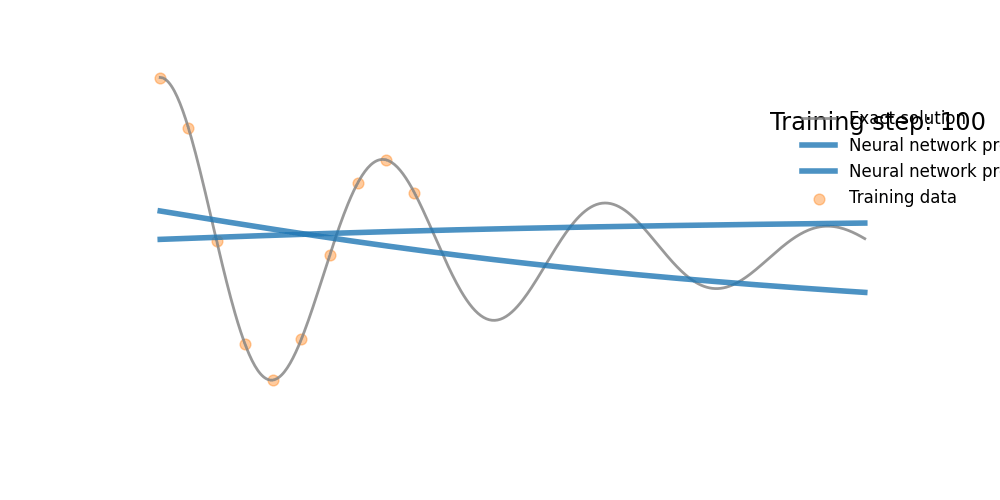

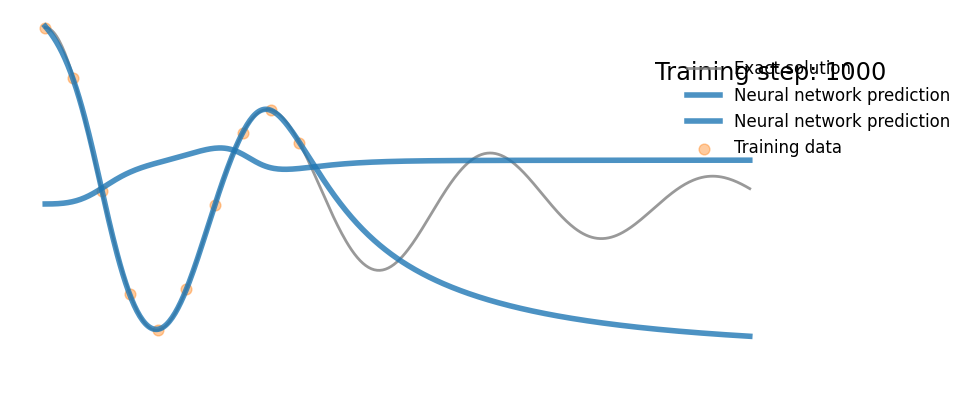

In [559]:
def plot_result(x,y,x_data,y_data,yh,fig,ax,images=[],xp=None):
    plt.cla()
    plt.plot(x,y, color="grey", linewidth=2, alpha=0.8, label="Exact solution")
    plt.plot(x,yh, color="tab:blue", linewidth=4, alpha=0.8, label="Neural network prediction")
    plt.scatter(x_data, y_data[:,0], s=60, color="tab:orange", alpha=0.4, label='Training data')
    if xp is not None:
        plt.scatter(xp, -0*torch.ones_like(xp), s=60, color="tab:green", alpha=0.4, 
                    label='Physics loss training locations')
    l = plt.legend(loc=(0.865,0.60), frameon=False, fontsize="large")
    plt.setp(l.get_texts(), color="k")
    plt.xlim(-0.05, 1.05)
    plt.ylim(-1.1, 1.1)
    plt.text(0.865,0.7,"Training step: %i"%(i+1),fontsize="xx-large",color="k")
    plt.axis("off")
    fig.canvas.draw() 
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)

    
# train standard neural network to fit training data
torch.manual_seed(123)
model = MLP(1,2,32)
optimizer = torch.optim.Adam(model.parameters(),lr=1e-3)
images = []
fig, ax = plt.subplots(figsize=(10,5))
y_data=torch.hstack((y_data,torch.ones(10,1)))
for i in range(1000):
    optimizer.zero_grad()
    yh = model(x_data)
    loss = torch.mean((yh[:,0:1]-y_data[:,0:1])**2)# use mean squared error
    loss.backward()
    optimizer.step()
    
    # plot the result as training progresses
    if (i+1) % 100 == 0: 
        print(loss.item())
        yh = model(x).detach()
        plot_result(x,y,x_data,y_data,yh,fig,ax,images)

from IPython.display import Image
a=imageio.mimsave('./training.gif', images, fps=10)
Image(open('training.gif','rb').read())

Now the fit is suprisingly good. In fact from the few points that we have fit so well, we can potentially start to glimmer how we can find the period, decay constant and other parameters of the fit. However this is actually not an obvious question, when you think about it. 

*Can you figure out how we extract period, force, other fundamental parameters from the NN?* 

The answer to this might not be so satisfying. The only way we really know how to do this is by relying on our original knowledge of the differential equation. 

Recall from the pendulum that we have 

$$
\ddot{x(t)} = -\frac{k}{m} x(t) - \mu\dot{x}
$$

From the above equation, we have computed $x(t)$, this is just our neural network, which I remind you **is differentiable**. Likewise, we can compute this quickly with pytorch. Let's go ahead and do that and take a look at what we see. 

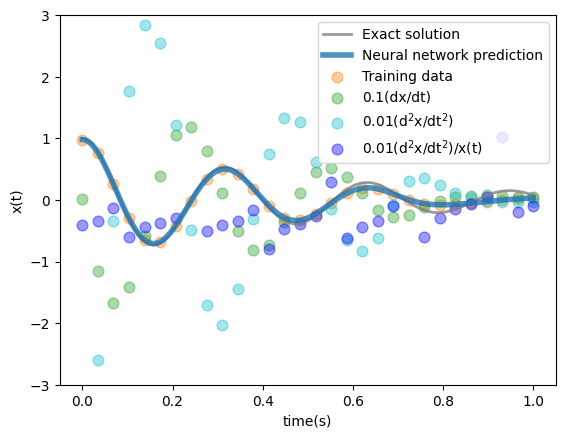

In [569]:
#First lets apply the model
x_physics = torch.linspace(0,1,30).view(-1,1).requires_grad_(True)
yhp = model(x_physics)
dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]# computes dy/dx
dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]# computes d^2y/dx^2
dx*=0.1
dx2*=0.01
plt.plot(x,y, color="grey", linewidth=2, alpha=0.8, label="Exact solution")
plt.plot(x,yh, color="tab:blue", linewidth=4, alpha=0.8, label="Neural network prediction")
plt.scatter(x_physics.detach(), yhp.detach(), s=60, color="tab:orange", alpha=0.4, label='Training data')
plt.scatter(x_physics.detach(), dx.detach(), s=60, color="tab:green", alpha=0.4, label='0.1(dx/dt)')
plt.scatter(x_physics.detach(), dx2.detach(), s=60, color="tab:cyan", alpha=0.4, label='0.01(d$^{2}$x/dt$^{2}$)')
plt.scatter(x_physics.detach(), 0.1*dx2.detach()/yhp.detach(), s=60, color="blue", alpha=0.4, label='0.01(d$^{2}$x/dt$^{2}$)/x(t)')
plt.ylim(-3,3)
plt.legend()
plt.xlabel("time(s)")
plt.ylabel("x(t)")
plt.show()


Now what this means is we can embed this function into our loss. What we will now do is what we discussed above. We will define two losses: 

 * Mean Squared Error Loss
 * Differential Equation residual
 
Where we we will now define our differential equation loss as we did above

$$
\mathcal{L} = \sum_{i} (x_{i}-f\left(t|\theta\right))^{2} + \mathcal{L_{\rm constrained}}\\
\mathcal{L_{\rm constrained}} = \left( m \ddot{x} + \mu\dot{x} +  kx \right)^2
$$

To make our lives simple, we will first do this with the knowledge of $\mu$ and $\omega_{0}$. However, we will eventually deviate away from this. 

0.3140140771865845
0.30982309579849243
0.30967995524406433
0.3096047639846802
0.3095202147960663
0.3094272017478943
0.30932608246803284
0.30921670794487
0.3090984523296356
0.308970183134079
0.30883049964904785
0.30867791175842285
0.3085111975669861
0.30833008885383606
0.30813655257225037
0.3079361021518707
0.3077387511730194
0.3075583279132843
0.3074079751968384
0.30729395151138306
0.30721181631088257
0.3071500062942505
0.30709654092788696
0.30704325437545776
0.3069854974746704
0.3069206178188324
0.3068462610244751
0.30675962567329407
0.30665722489356995
0.3065335154533386
0.3063802123069763
0.3061828017234802
0.3059125244617462
0.3055025339126587
0.3047601580619812
0.30304986238479614
0.29823368787765503
0.2822871208190918
0.2314624935388565
0.18004752695560455
0.15650394558906555
0.14365142583847046
0.1337871253490448
0.124823197722435
0.11593686044216156
0.10713866353034973
0.09872850775718689
0.09088937938213348
0.08375930041074753
0.07735918462276459
0.07203705608844757
0.06707648

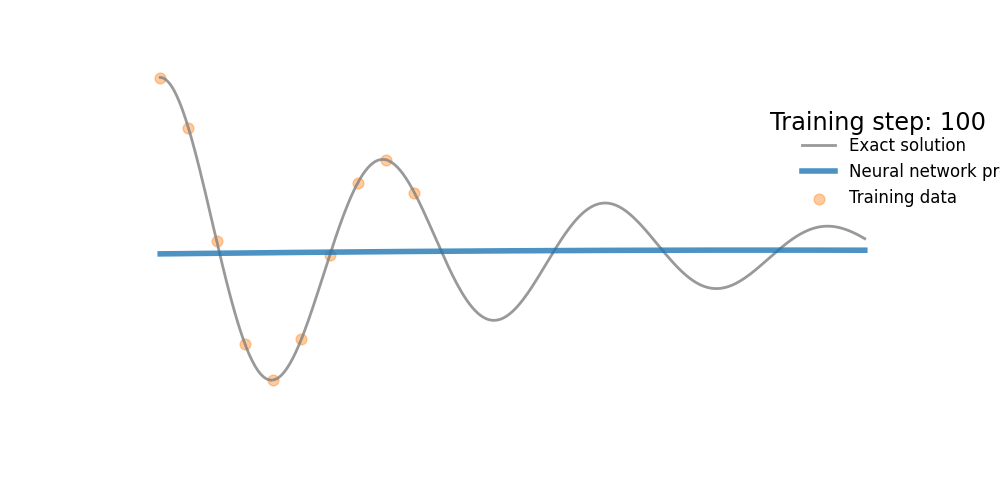

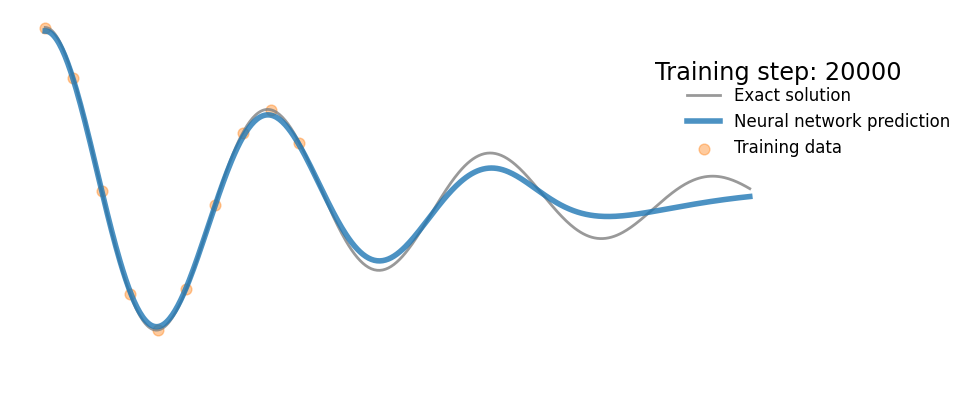

In [567]:
#x_physics = torch.linspace(0,1,30).view(-1,1).requires_grad_(True)# sample locations over the problem domain
mu, k = 2*d, w0**2
model = MLP(1,1,32)
optimizer = torch.optim.Adam(model.parameters(),lr=1e-4)

torch.manual_seed(123)
images = []
fig, ax = plt.subplots(figsize=(10,5))
for i in range(20000):
    optimizer.zero_grad()
    
    # compute the "data loss"
    yh = model(x_data)
    loss1 = torch.mean((yh[:,0:1]-y_data[:,0:1])**2)# use mean squared error

    # compute the "physics loss"
    yhp = model(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]# computes dy/dx
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]# computes d^2y/dx^2
    physics = dx2 +  mu*dx +  k*yhp# computes the residual of the 1D harmonic oscillator differential equation
    loss2 = (1e-4)*torch.mean(physics**2)
    
    # backpropagate joint loss
    loss = loss1 + loss2# add two loss terms together
    loss.backward()
    optimizer.step()
    
    
    # plot the result as training progresses
    if (i+1) % 100 == 0: 
        
        yh = model(x).detach()
        xp = x_physics.detach()

        print(loss.item())
        yh = model(x).detach()
        plot_result(x,y,x_data,y_data,yh,fig,ax,images)

from IPython.display import Image
a=imageio.mimsave('./training.gif', images, fps=10)
Image(open('training.gif','rb').read())

I have to say I am starting to get amazed. Our neural network is prediciting the whole shape of the the decaying exponent just with the knowledge of a few datapoints, and the full differential equation. Its really extrapoloating far away from what we have done. 

However, we have kind of cheated since we embedded in the loss a knowledge of the physics parameters that we are using. Let's try to learn these parameters too, so that we really learn everything. 

The way we are going to do this is we are going to make two neural networks and run them simultaneously. We will train one for our prediction, and we will train one for our parameters. I know this is kind of crazy, but let's see how it goes?

0.2942875623703003
0.2930077612400055
0.2919342815876007
0.29112306237220764
0.29042765498161316
0.2895473837852478
0.28817740082740784
0.2857652008533478
0.2808529734611511
0.2692255675792694
0.2371772825717926
0.17884628474712372
0.15956556797027588
0.1566423773765564
0.15477369725704193
0.15287774801254272
0.15050311386585236
0.1471169888973236
0.14194601774215698
0.13817593455314636
0.1356181651353836
0.13357391953468323
0.13183878362178802
0.13031309843063354
0.12893237173557281
0.12765337526798248
0.12644854187965393
0.1252957582473755
0.12418025732040405
0.12309233844280243
0.12202436476945877
0.12096904218196869
0.11992177367210388
0.11887490749359131
0.11782369017601013
0.11676524579524994
0.1156950369477272
0.11461259424686432
0.11351596564054489
0.11240468919277191
0.11128067970275879
0.1101519912481308
0.10899350047111511
0.10784056782722473
0.1066635251045227
0.10548374056816101
0.10429568588733673
0.1031021773815155
0.1019078940153122
0.10070325434207916
0.099499613046646

0.0023390455171465874
0.0023332538548856974
0.00232923636212945
0.0023265324998646975
0.002321994863450527
0.0023880507797002792
0.0023125330917537212
0.0023078657686710358
0.002310481620952487
0.0023195198737084866
0.002294243546202779
0.002289618831127882
0.0022851002868264914
0.0022801575250923634
0.0022760580759495497
0.0022739414125680923
0.002271967474371195
0.0022590854205191135
0.0022539817728102207
0.0022478383034467697
0.0023621395230293274
0.002235556021332741
0.002236544154584408
0.002244583796709776
0.0022155283950269222
0.0022124587558209896
0.002202330157160759
0.002194375032559037
0.002207570243626833
0.002240279223769903
0.0021662223152816296
0.0021566408686339855
0.002146644052118063
0.0021394819486886263
0.002144737634807825
0.0021214354783296585
0.002128485357388854
0.0020882755052298307
0.002096340525895357
0.0020575914531946182
0.002042554784566164
0.002172387670725584
0.0020300045143812895
0.001992402598261833
0.0019745498429983854
0.00199919193983078
0.001939617

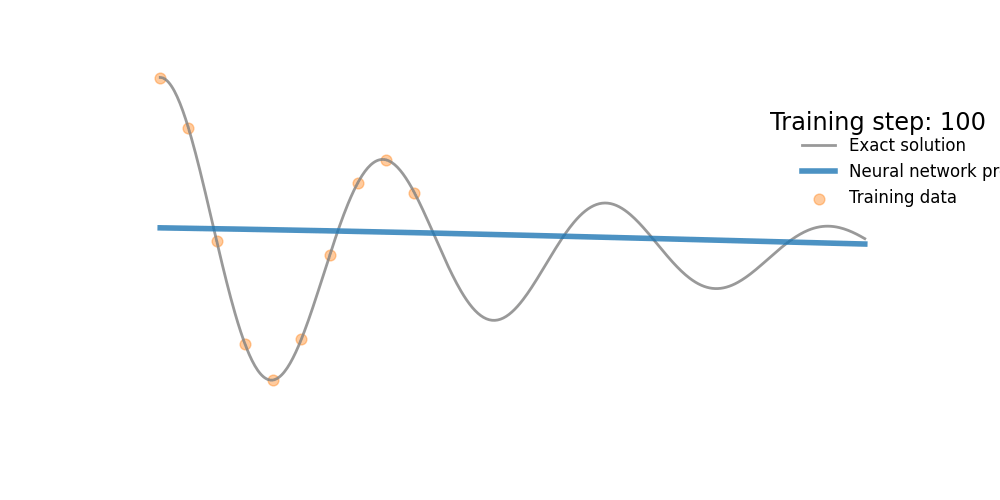

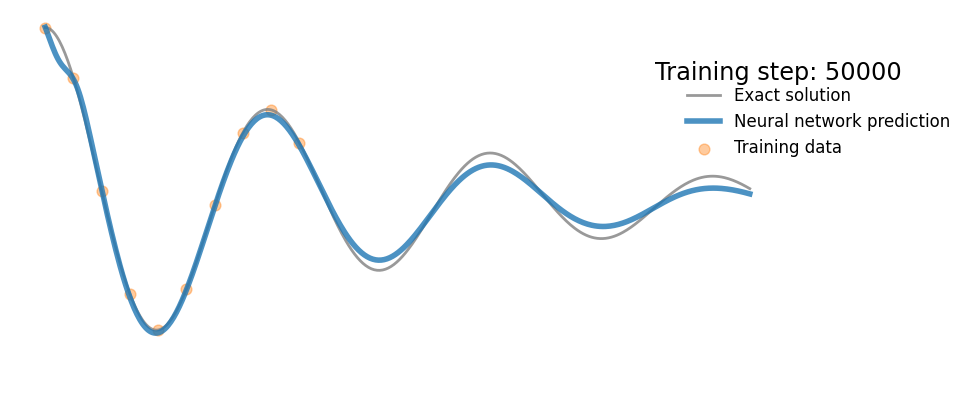

In [570]:
#x_physics = torch.linspace(0,1,30).view(-1,1).requires_grad_(True)# sample locations over the problem domain
mu, k = 2*d, w0**2
model1 = MLP(1,1,32)
model2 = MLP(1,2,1)
#model2.Train = False

optimizer1 = torch.optim.Adam(model1.parameters(),lr=1e-4)
optimizer2 = torch.optim.Adam(model2.parameters(),lr=1e-2)

torch.manual_seed(123)
images = []
fig, ax = plt.subplots(figsize=(10,5))
for i in range(50000):
    optimizer1.zero_grad()
    optimizer2.zero_grad()
    
    # compute the "data loss"
    yh = model1(x_data)
    loss1 = torch.mean((yh[:,0:1]-y_data[:,0:1])**2)# use mean squared error

    # compute the "physics loss"
    yhp   = model1(x_physics)
    decay = model2(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]# computes dy/dx
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]# computes d^2y/dx^2
    physics = dx2 +  torch.mean(decay[:,0:1])*dx +  torch.mean(decay[:,1:2])*yhp# computes the residual of the 1D harmonic oscillator differential equation
    loss2 = (1e-4)*torch.mean(physics**2)
    
    # backpropagate joint loss
    loss = loss1 + loss2# add two loss terms together
    loss.backward()
    optimizer1.step()
    optimizer2.step()
    
    
    # plot the result as training progresses
    if (i+1) % 100 == 0: 
        
        yh = model1(x).detach()
        xp = x_physics.detach()

        print(loss.item())
        yh = model1(x).detach()
        plot_result(x,y,x_data,y_data,yh,fig,ax,images)

from IPython.display import Image
a=imageio.mimsave('./training.gif', images, fps=10)
Image(open('training.gif','rb').read())

Ok, now we need to see if the values make sense. Let's look at the output of our decay neural network and see what parameters it has predicted.

In [571]:
decays=model2(x_physics)
print("NN Mu:",decays[0][0].detach().numpy(),"Actual:",mu,"NN k: ",decays[0][1].detach().numpy(),"Actual:",k)

NN Mu: 5.1925974 Actual: 4 NN k:  399.24002 Actual: 400


So we have pretty good numbers. For our decay constant ($\mu$) we are a bit high. However, for our frequency (spring constant $k$) we are spot on, and we can predict the future. I know this seems kind of dumb, but I want to stress that we are giving the neural network 10 points and a constraint on the differential equation, and we are telling it to make a full prediction for the future. I don't know about you, but I am impressed. Just imagine trying to code up a much more complicated problems, its not that hard. 

One thing to note is that the neural network is pretty slow. It takes time to get this to converge. 

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.9.1 </span>

Add some just one data point at the end and re-run the neural network above. What does this do for the found decay parameter?  

In [ ]:
#lets add the last datapoint
n=len(x)
x_data = torch.vstack((x[0:200:20],x[n-100:-1:20]))
y_data = torch.vstack((y[0:200:20],y[n-100:-1:20]))
print(x_data.shape, y_data.shape)

model1 = MLP(1,1,32)
model2 = MLP(1,2,1)
#model2.Train = False

optimizer1 = torch.optim.Adam(model1.parameters(),lr=1e-4)
optimizer2 = torch.optim.Adam(model2.parameters(),lr=1e-2)

torch.manual_seed(123)
images = []
fig, ax = plt.subplots(figsize=(10,5))
for i in range(50000):
    optimizer1.zero_grad()
    optimizer2.zero_grad()
    
    # compute the "data loss"
    yh = model1(x_data)
    loss1 = torch.mean((yh[:,0:1]-y_data[:,0:1])**2)# use mean squared error

    # compute the "physics loss"
    yhp   = model1(x_physics)
    decay = model2(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]# computes dy/dx
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]# computes d^2y/dx^2
    physics = dx2 +  torch.mean(decay[:,0:1])*dx +  torch.mean(decay[:,1:2])*yhp# computes the residual of the 1D harmonic oscillator differential equation
    loss2 = (1e-4)*torch.mean(physics**2)
    
    # backpropagate joint loss
    loss = loss1 + loss2# add two loss terms together
    loss.backward()
    optimizer1.step()
    optimizer2.step()
    
    
    # plot the result as training progresses
    if (i+1) % 500 == 0: 
        
        yh = model1(x).detach()
        xp = x_physics.detach()
        if (i+1) % 1000 == 0:
            print(loss.item())
        yh = model1(x).detach()
        plot_result(x,y,x_data,y_data,yh,fig,ax,images)

from IPython.display import Image
a=imageio.mimsave('./training.gif', images, fps=10)
Image(open('training.gif','rb').read())

<a name='section_15_9'></a>
<hr style="height: 1px;">

## <h2 style="border:1px; border-style:solid; padding: 0.25em; color: #FFFFFF; background-color: #90409C">L15.10 Computing the Dark Matter Relic Density </h2>  


Finally, we would like to solve a more complicated differential equation using python numerical methods. In light of that, lets take the numerical differential equation that I have tried to solve the most. The computation of the dark matter relic density in current Universe. *Yes! this is just a 1D numerical ODE*

Now finally, we would like to use our differential equation tools to solve for a useful modern physics calculation. In this case, what we will do is predict the amount of dark matter. In the early universe, dark matter and matter are all thermalized interacting. 

The way we can think about this is dark matter ($\chi$) and matter, such as quarks($q$) is interacting in a chemical equation: 
$$
 \chi + \chi \leftrightarrow q + \bar{q} 
$$
Now as the universe expands it gets colder and colder. This changes the temperature, $T$. We often write the temperature in terms a mass scale we call $x=m/T$. What this means is that when the tempreature is above the mass $m$ ($x > 1$) then can have objects with mass $m$ interact in thermal equilibrium in the early universe. 

As the temperature goes down the fraction of objects that are in thermal equilibrium becomes smaller and smaller. The matter than cannot thermalize "Freezes out", or in otherwords no more of this matter is produced and it is not interacting with the universe anymore so the total amount of matter remains. 

For Dark Matter our goal is to estimate the final dark matter density by constructing a differential equation for how the universe is goverened. We can write this differential equation in terms of $Y$, the dark matter density $n$ divided by the volume of the university.  We can write $Y$ in terms of the boltzmann number density given by 

$$
n = g\left(\frac{mT}{2\pi}\right)^{3/2} e^{-m/T} \\
Y = \frac{n}{T^{3}} = \frac{g}{(2\pi)^{3/2}} x^{3/2} e^{-x} \\
$$
We don't need go into detail, but the important thing is we get a dependence of $Y$ on the temperature $x$, and the interaction strength $g$. This value $g$ is actually a function $g(T)$  which tells us how readily standard model particles interact at a specific temperature in the early universe. A full description of $g$ and the function can be found [here](https://www.physics.uci.edu/~tanedo/files/notes/DMNotes.pdf) suffice it to say, we will treat this as a constant $g$ for now.  We can write the evolution of the number of particles in high level terms by noting the interaction is proporitional to the probability that two particles meet each other, which we can write as the number density $n^{2}$. Thus our deviation from equilibrium give  us

$$
\frac{dn}{dt} = - ({\rm Interaction rate}) (n-n_{\rm eq})^2
$$

Now translating this into $Y$ and doing all the detailed physics part, we can write this in terms of the particle interaction rate $\langle\sigma v\rangle$ (velocity averagec cross section) as a derivative that is a function of $x$ the scale parameter that describes the expansion of the universe. We get the following differential equation written in terms of the plank mass $m_P$ and the previously described couplings. 

$$
\frac{dY}{dx} = - m m_{P} \frac{g}{\sqrt{g_{*S}}} \left(\frac{2\pi\sqrt{90}}{45}\right)\frac{1}{x^{2}}\langle\sigma v\rangle\left(Y^{2}-Y^{2}_{\rm eq}\right) \\
\frac{dY}{dx} = - 1.32 m m_{P} \frac{g}{\sqrt{g_{*S}}}   \frac{1}{x^{2}}\langle\sigma v\rangle\left(Y^{2}-Y^{2}_{\rm eq}\right) \\
Y_{\rm eq}(x)=\frac{45}{2\pi^{4}}\frac{g}{g_{*S}}x^{3/2}e^{-x}=0.145\frac{g}{g_{*S}}x^{3/2}e^{-x}
$$

Now, we can just take the bottom two equations and plug them into our numerical solver. This will get us the right dark matter relic density.  Let's go ahead and see if we can do this for a dark matter mass of 100 GeV. Additionally for this, we are going to take values of $g=2$, which just means our dark matter is spin $1/2$, and we will take $g_{*S}=50$, which dictates the number of degrees of freedom at the early universe.  

Also, for this we will scan $\langle\sigma v\rangle$. However, with some quantum field theory, we can calcualte this value. What you should know is that values of anywhere from $10^{-8}$ to $10^{-14}$ is a reasonable number. 

For reference, the actual value of $g_{*S}$ as a funciton of tempearture is shown here: 
![here](gvT.png)

What we see is that higher temeraputres, we have more degrees of freedom corresponding to access to more particles. Lastly, before we go ahead and solve this equation, we want to say that to tweak everything we had to limit the step size in the integrator using the hmax, command.  

In [ ]:
m = 100                                #GeV DM Mass
Mp = 1.22e19                            #GeV Planck Mass

def g_good_fancy(T):
    g_out = np.where(T < 0.00103107, 10, 20)
    g_out = np.where(T<0.11748257, g_out,  40)
    g_out = np.where(T<0.22748515, g_out,  70)
    g_out = np.where(T<8.6167, g_out, 90)
    g_out = np.where(T<162.48, g_out, 105)
    return g_out

def g_good(T):
    return 50

def Yeq(x,m=100,g=2):
    return 0.145*x**(3/2)*g/g_good(m/x)*np.exp(-x)

def BEx(x,m=100,sigmav=1e-12,g=2):
    return 1.32 *(m*Mp)*sigmav*g/np.sqrt(g_good(m/x))/x**2   
    
def dYdx(Y,x,sigmav=1e-12,m=100):
    #return -(Y**2-Yequilibrium(x)**2)*BEx(x)   #putting together the things to have the right formula
    return -(Y**2-Yeq(x)**2)*BEx(x,sigmav=sigmav,m=m)   #putting together the things to have the right formula

xx=np.logspace(np.log10(1),np.log10(1000),1000)
#plt.loglog(xx, Yequilibrium(xx),'m',label=r'$Y_{\rm equilib}$')
plt.loglog(xx, Yeq(xx),'r',label=r'$Y_{\rm eq}$')

plt.ylim(1E-14,1)
plt.xlim(1,1000)
plt.xlabel('$x = m/T$', size= 15)
plt.ylabel('$Y$', size= 15)
#plt.title('$m = 100$ GeV', size= 15)
plt.grid()

x=np.linspace(1,1000,100000)
Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-11,))
plt.loglog(x,Yc,':',label='$\sigma v=10^{-11}$')

#Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-10,))
#plt.loglog(x,Yc,':',label='$\sigma v=10^{-10}$')

Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-9,),hmax=0.002)
plt.loglog(x,Yc,':',label='$\sigma v=10^{-9}$')


Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-8,),hmax=0.002)
plt.loglog(x,Yc,':',label='$\sigma v=10^{-8}$')


plt.hlines(0.78E-11,1,1000,linestyles='-',color='g',lw=2,label='$Y_0 (Current Dark Matter)$')
plt.legend()
plt.show()


Now what we observe is that hte smaller the intrecaction strength the more dark matter there is in the universe. We can see that we we get waaay more DM (x1000) if our intercation strength is 1000 times smaller, thats crazy.  
Let's now scan a few things for fun to get an understanding of what is going on. 

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.10.1 </span>

Repeat the above exercise with $\sigma v=10^{-8}$ but now varying the mass at points m=1,10,100,100? How does the cross section change with mass? 

In [ ]:
xx=np.logspace(np.log10(1),np.log10(1000),1000)
plt.loglog(xx, Yeq(xx),'r',label=r'$Y_{\rm eq}$')

plt.ylim(1E-14,1)
plt.xlim(1,1000)
plt.xlabel('$x = m/T$', size= 15)
plt.ylabel('$Y$', size= 15)
plt.grid()

x=np.linspace(1,1000,100000)
Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-8,1),hmax=0.002)
plt.loglog(x,Yc,':',label='$\sigma v=10^{-8}$ m=1 GeV')

Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-8,10),hmax=0.002)
plt.loglog(x,Yc,':',label='$\sigma v=10^{-8}$ m=10 GeV')

Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-8,100),hmax=0.002)
plt.loglog(x,Yc,':',label='$\sigma v=10^{-8}$ m=100 GeV')

Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-8,1000),hmax=0.002)
plt.loglog(x,Yc,':',label='$\sigma v=10^{-8}$ m=1000 GeV')

plt.hlines(0.78E-11,1,1000,linestyles='-',color='g',lw=2,label='$Y_0 (Current Dark Matter)$')
plt.legend()
plt.show()

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
The lighter the DM the more we have
</pre>
        
**EXPLANATION:**
This plot was one of the main motivations for the light dark matter revolution that is happened in the last decade. While this plot has been known for a long time that lighter dark matter leads to more dark matter in the early universe, what we realized recently is that we can tune $\langle \sigma v\rangle$ to make it larger and larger so that we can match the right dark matter relic density. 
    
</div>

### <span style="border:3px; border-style:solid; padding: 0.15em; border-color: #90409C; color: #90409C;">Ex-15.10.2 </span>

Now, try running the calucation with the g_good function that is placed in the cod above, do this for m=100 GeV, and $\langle\sigma v\rangle = 10^{-8}$. How does this change the DM density? 

In [ ]:
def Yeq_fancy(x,m=100,g=2):
    return 0.145*x**(3/2)*g/g_good_fancy(m/x)*np.exp(-x)

def BEx_fancy(x,m=100,sigmav=1e-12,g=2):
    return 1.32 *(m*Mp)*sigmav*g/np.sqrt(g_good_fancy(m/x))/x**2   

def dYdx_fancy(Y,x,sigmav=1e-12,m=100):
    return -(Y**2-Yeq_fancy(x)**2)*BEx_fancy(x,sigmav=sigmav,m=m)   #putting together the things to have the right formula

xx=np.logspace(np.log10(1),np.log10(1000),1000)
plt.loglog(xx, Yeq(xx),'r',label=r'$Y_{\rm eq}$')

plt.ylim(1E-14,1)
plt.xlim(1,1000)
plt.xlabel('$x = m/T$', size= 15)
plt.ylabel('$Y$', size= 15)
plt.grid()

x=np.linspace(1,1000,100000)
Yc=integrate.odeint(dYdx,Yeq(x[0]),x,args=(1e-8,100),hmax=0.002)
plt.loglog(x,Yc,':',label='$\sigma v=10^{-8}$ m=100 GeV')

Yc_fancy=integrate.odeint(dYdx_fancy,Yeq_fancy(x[0]),x,args=(1e-8,100),hmax=0.002)
plt.loglog(x,Yc_fancy,':',label='$\sigma v=10^{-8}$ m=100 GeV')

plt.hlines(0.78E-11,1,1000,linestyles='-',color='g',lw=2,label='$Y_0 (Current Dark Matter)$')
plt.legend()
plt.show()

print("Final DM density:",Yc[-1],"Fully correct DM Density:",Yc_fancy[-1])

<div style="border:1.5px; border-style:solid; padding: 0.5em; border-color: #90409C; color: #90409C;">

**SOLUTION:**

<pre>
DM density goes down by 15%
</pre>
        
**EXPLANATION:**
While its hard to see in the plot above, we are talking about 15 percnet of the whole universe's dark matter density. Being ever so precise is critical for good performance.  
    
</div>